In [1]:
import sys
sys.path.insert(0, "../lib")

In [28]:
import math
import os
import pathlib
import re

import scvi
import scanpy as sc
import numpy as np
import pandas as pd
import sc_utils
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import sankey

In [3]:
torch.cuda.is_available()

True

In [4]:
%config InlineBackend.figure_format = "retina"

In [5]:
mpl.rcParams["figure.figsize"] = (10, 8)
pd.options.display.max_rows = 200

In [6]:
DATA = pathlib.Path('../../data/31_bal-object/')

In [7]:
adata_prev = pd.read_csv('../../data/20bal-object/04bal-object/04bal-object-metadata.csv', index_col=0)

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/venv/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (7,10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [8]:
adata = sc.read_h5ad(DATA / "02_integrated.h5ad")

In [ ]:
adata.obs.index = (
    adata.obs['External Sample ID'].astype(str)
    + '_'
    + adata.obs.index.str.replace('-.+$', '', regex=True)
)

In [10]:
adata_raw = sc.read_h5ad(DATA / "raw_object.h5ad")

In [ ]:
adata_raw.obs.index = (
    adata_raw.obs['External Sample ID'].astype(str)
    + '_'
    + adata_raw.obs.index.str.replace('-.+$', '', regex=True)
)

In [12]:
adata_30 = sc.read_h5ad("../../data/30_bal-object/03_annotated.h5ad")

In [13]:
adata_30 = adata_30.obs

In [14]:
markers = sc_utils.get_markers(adata, "leiden_scVI")

In [15]:
markers.cluster = markers.cluster.astype(int)

In [16]:
markers.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [17]:
markers.groupby("cluster").head(9)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
0,0.000000e+00,2.277433,0.858966,0.426099,0.000000e+00,0,INHBA
74,0.000000e+00,1.821349,0.266013,0.109165,0.000000e+00,0,SPOCD1
8,0.000000e+00,1.709313,0.678954,0.382673,0.000000e+00,0,TGM2
70,0.000000e+00,1.617361,0.302517,0.144327,0.000000e+00,0,SLC19A3
2,0.000000e+00,1.611322,0.859878,0.564177,0.000000e+00,0,TFRC
165,0.000000e+00,1.497318,0.216581,0.098896,0.000000e+00,0,CSF1
131,0.000000e+00,1.492954,0.236250,0.118373,0.000000e+00,0,MGAT3
9,0.000000e+00,1.440885,0.769286,0.490719,0.000000e+00,0,LPL
1,0.000000e+00,1.437869,0.948126,0.674157,0.000000e+00,0,MCEMP1
282,0.000000e+00,7.722031,0.159796,0.002050,0.000000e+00,1,CD8B


<AxesSubplot:xlabel='leiden scVI', ylabel='total_counts'>

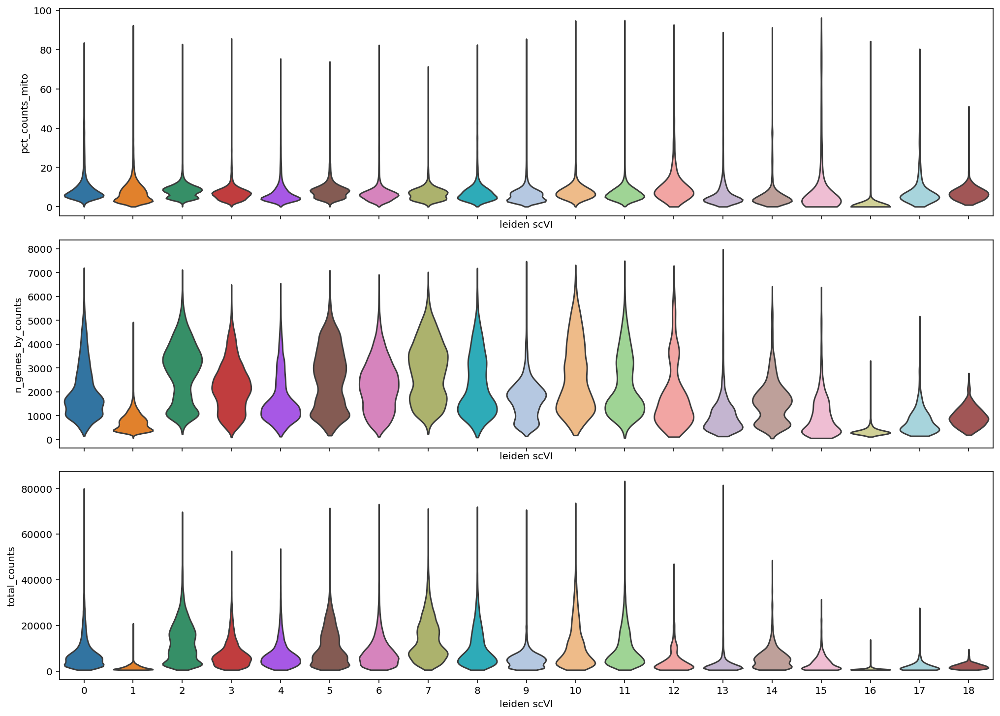

In [18]:
fig, ax = plt.subplots(nrows=3, figsize=(14, 10), constrained_layout=True, sharex=True)

sc.pl.violin(adata, "pct_counts_mito", groupby="leiden_scVI", ax=ax[0], show=False, size=0)
sc.pl.violin(adata, "n_genes_by_counts", groupby="leiden_scVI", ax=ax[1], show=False, size=0)
sc.pl.violin(adata, "total_counts", groupby="leiden_scVI", ax=ax[2], show=False, size=0)

<AxesSubplot:title={'center':'leiden_scVI'}, xlabel='UMAP1', ylabel='UMAP2'>

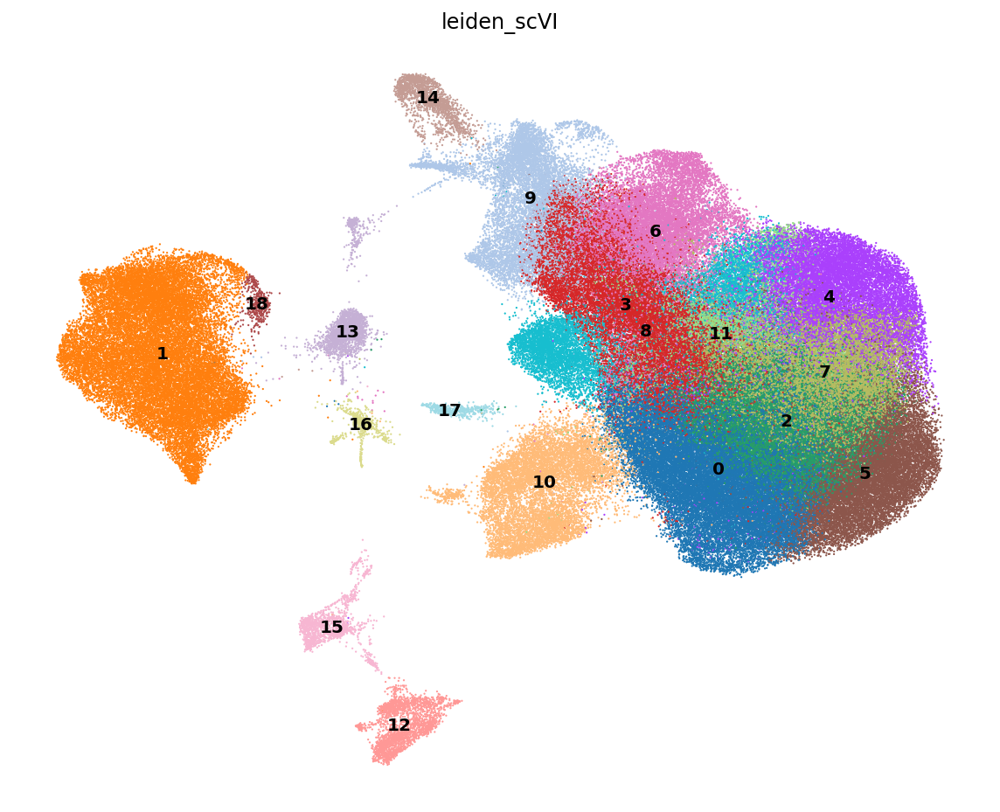

In [ ]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

[<AxesSubplot:title={'center':'leiden_scVI'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CD1C'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CD1E'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CCL2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'SPP1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'FABP4'}, xlabel='UMAP1', ylabel='UMAP2'>]

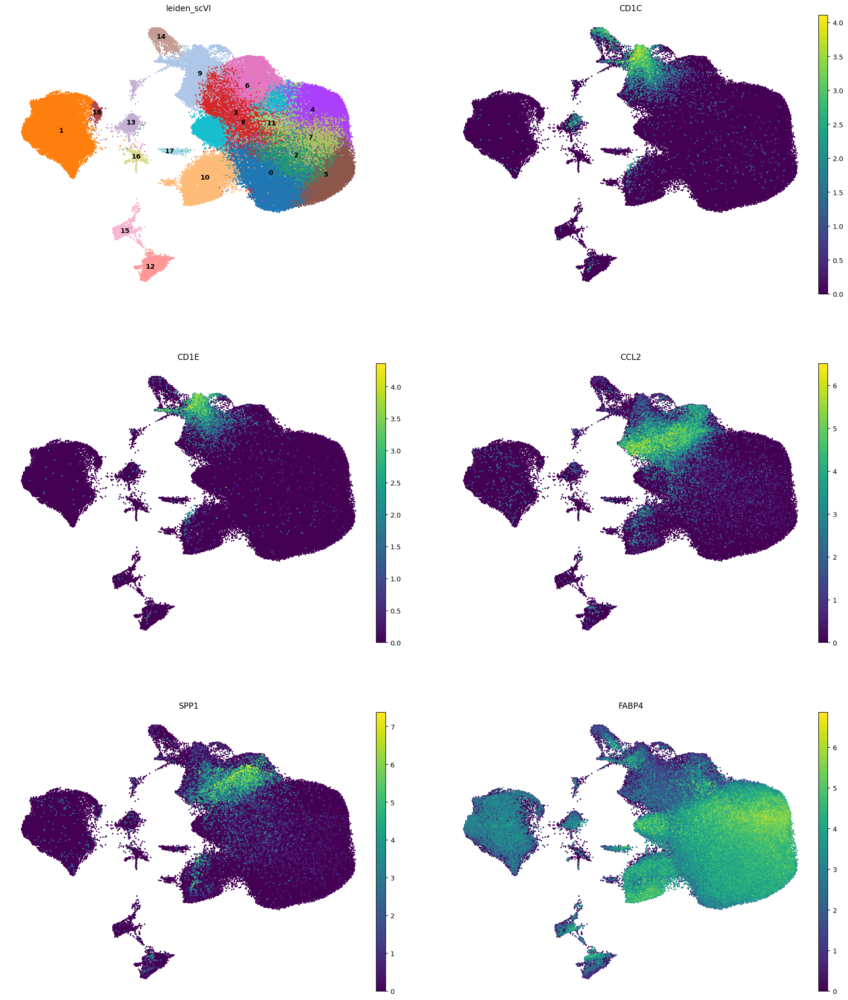

In [ ]:
sc.pl.umap(
    adata,
    color=["leiden_scVI", "CD1C", "CD1E", "CCL2", 'SPP1', 'FABP4'],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=20,
    ncols=2
)

<AxesSubplot:title={'center':'Leiden_scvi by Patient'}>

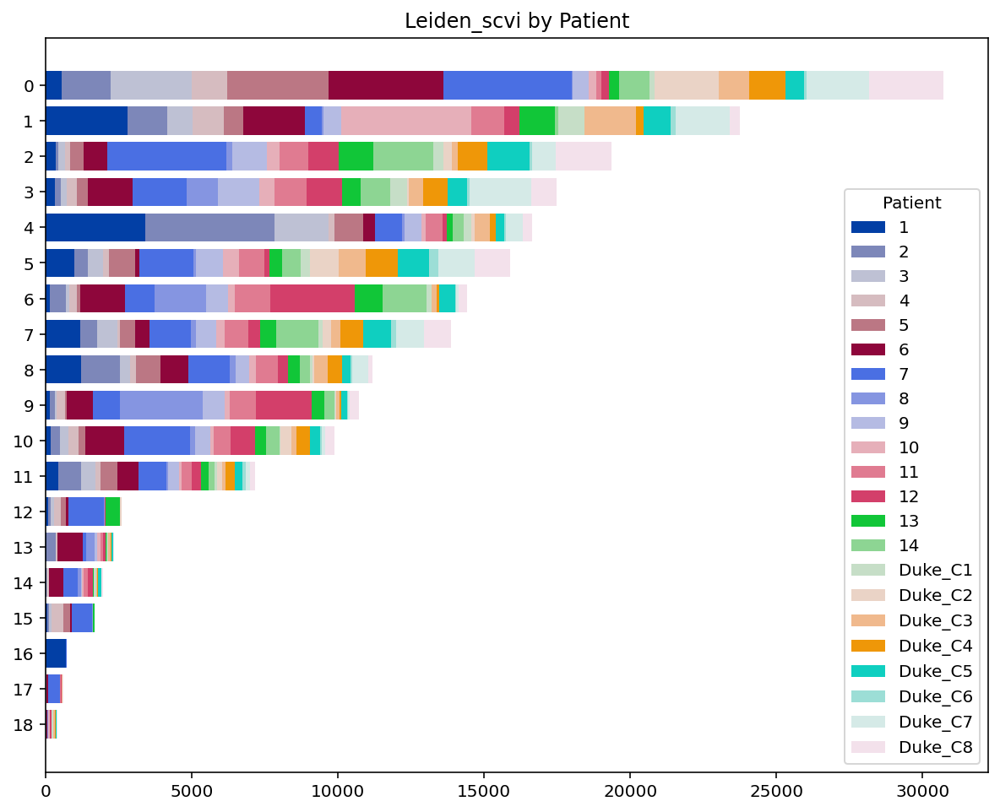

In [21]:
sc_utils.plot_composition(adata, group_by="leiden_scVI", color="Patient")

In [ ]:
prev_ct = adata_prev.loc[
    adata.obs_names[adata.obs_names.isin(adata_prev.index)],
    'cell_type'
].copy()

In [23]:
prev_ct = pd.concat([
    prev_ct,
    pd.Series('DELETED', index=adata.obs_names[~adata.obs_names.isin(prev_ct.index)])
])

In [24]:
prev_ct[adata.obs_names[adata.obs.Study.eq('Duke')]] = 'Duke'

In [25]:
adata_30 = adata_30.loc[
    adata.obs_names[adata.obs_names.isin(adata_30.index)],
    'cell_type'
].copy()

In [26]:
adata_30 = pd.concat([
    adata_30,
    pd.Series('DELETED', index=adata.obs_names[~adata.obs_names.isin(adata_30.index)])
])

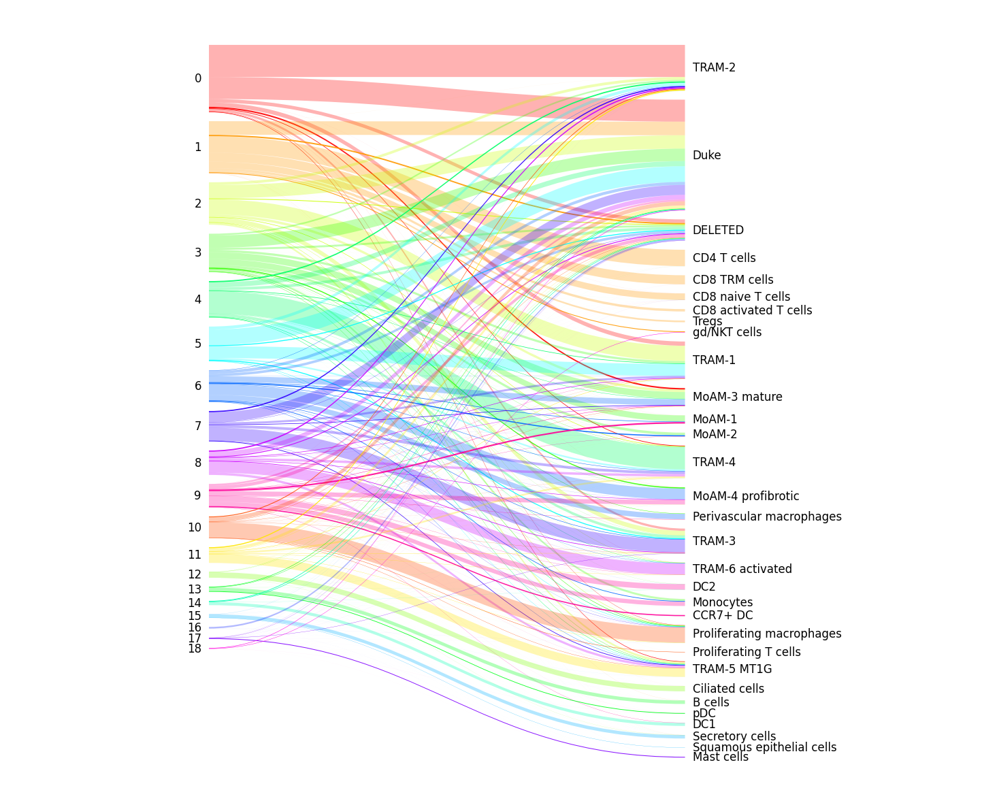

In [29]:
sankey.sankey(adata.obs.leiden_scVI, prev_ct[adata.obs_names]);

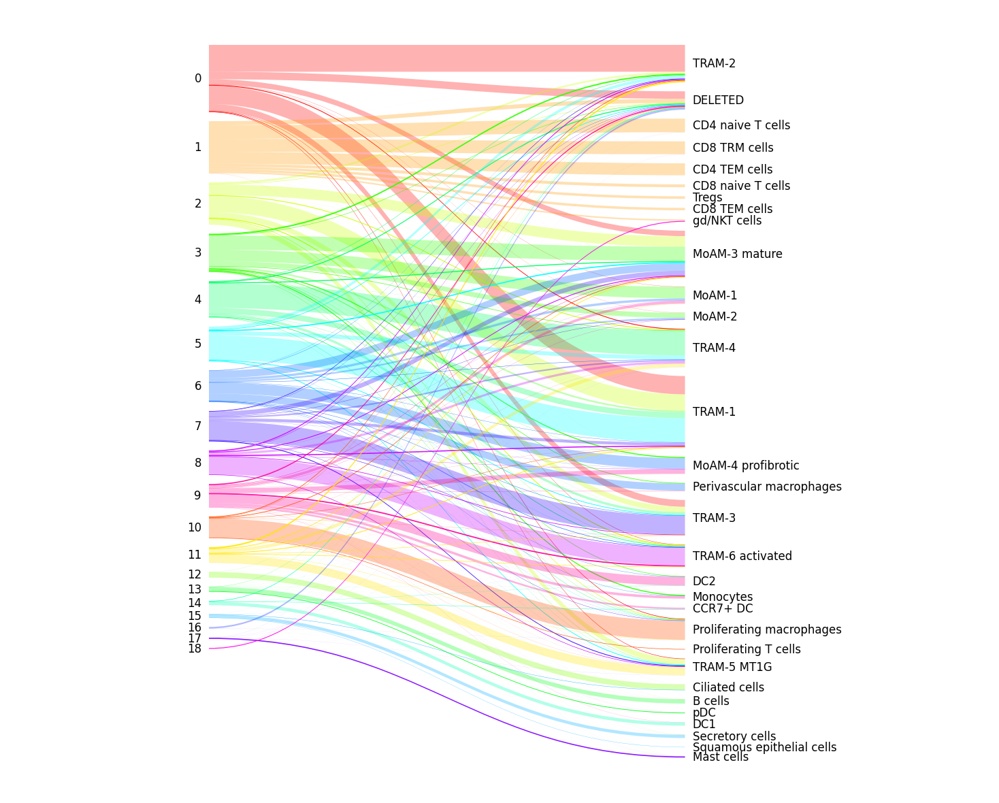

In [32]:
sankey.sankey(adata.obs.leiden_scVI, adata_30[adata.obs_names]);

# 1. Recipe

1. Recluster T cells = 2
2. Recluster DCs = 11
3. Recluster MoAMs = 0

In [33]:
adata_raw = adata_raw[adata_raw.obs_names.isin(adata.obs_names), :].copy()

In [34]:
sc.pp.normalize_total(adata_raw, target_sum=1e4)
sc.pp.log1p(adata_raw)

In [35]:
adata_raw.raw = adata_raw

# 2. Recluster Cluster 1 T cells

In [36]:
del adata.obsm['_scvi_extra_categoricals']

Based on these marker genes, we see we need to select HVGs for T cells de novo, and go from there. So let's integrate only T cells with scVI

In [37]:
assert all(adata.obs_names == adata_raw.obs_names)

In [38]:
cl1 = adata_raw[adata.obs.leiden_scVI.isin(['1', '18']), :].copy()

In [39]:
cl1.shape

(24153, 25538)

In [40]:
sc.pp.highly_variable_genes(
    cl1,
    layer="counts",
    flavor="seurat_v3",
    n_top_genes=500,
    span=0.9,
    subset=True,
    batch_key="Patient"
)

In [41]:
scvi.model.SCVI.setup_anndata(
    cl1,
    layer="counts",
    batch_key="Patient",
    categorical_covariate_keys=["Chemistry"]
)

INFO     Using batches from adata.obs["Patient"]                                             
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 24153 cells, 500 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [42]:
cl1_model = scvi.model.SCVI(cl1, n_layers=2, dropout_rate=0.2, n_latent=10)

In [43]:
model_cache = "models/03_cluster1.model"
if os.path.exists(model_cache):
    cl1_model = scvi.model.SCVI.load(model_cache, cl1)
else:
    cl1_model.train(
        max_epochs=400,
        use_gpu=True,
        check_val_every_n_epoch=2,
        early_stopping=True
    )
    cl1_model.save(model_cache)

INFO     Using data from adata.layers["counts"]                                              
INFO     Registered keys:['X', 'batch_indices', 'labels', 'cat_covs']                        
INFO     Successfully registered anndata object containing 24153 cells, 500 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              


/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/venv/lib/python3.9/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function transfer_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.
  warnings.warn(msg, category=FutureWarning)


In [44]:
cl1.obsm["X_scVI"] = cl1_model.get_latent_representation()

In [45]:
sc.pp.neighbors(cl1, use_rep="X_scVI")
sc.tl.umap(cl1, min_dist=0.3)

In [46]:
sc.tl.leiden(cl1, resolution=0.4)

[<AxesSubplot:title={'center':'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'FOXP3'}, xlabel='UMAP1', ylabel='UMAP2'>]

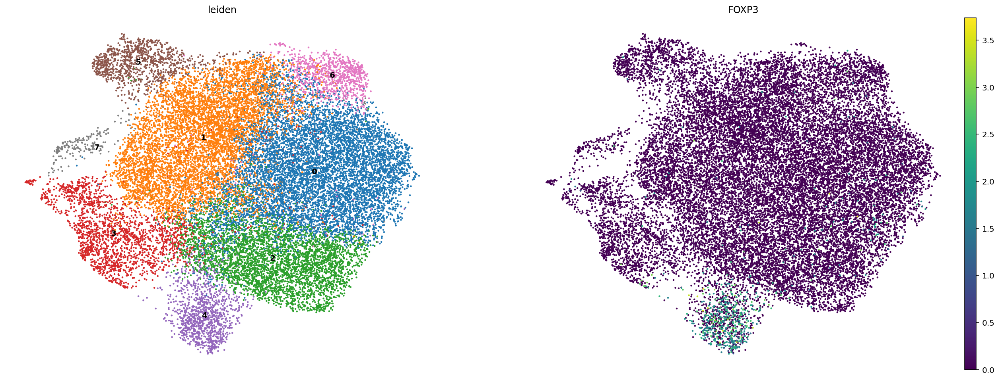

In [ ]:
sc.pl.umap(
    cl1,
    color=["leiden", "FOXP3"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=20
)

In [48]:
sc.tl.rank_genes_groups(cl1, "leiden", method="t-test", n_genes=200)

In [49]:
markers_1 = sc_utils.get_markers(cl1, "leiden")

In [50]:
markers_1.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [51]:
markers_1.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
95,1.746590e-59,3.107897,0.049543,0.005569,1.746590e-59,0,IL26
80,3.301492e-63,2.328809,0.066433,0.013738,3.301492e-63,0,RP5-1028K7.2
11,3.374181e-271,2.275620,0.277368,0.074629,3.374181e-271,0,CD40LG
149,3.830332e-45,2.078393,0.053547,0.011943,3.830332e-45,0,IL23R
25,9.519769e-131,2.071569,0.153885,0.039913,9.519769e-131,0,IFNG
200,0.000000e+00,3.137341,0.933809,0.480075,0.000000e+00,1,CCL5
204,0.000000e+00,2.906037,0.319265,0.064215,0.000000e+00,1,KLRC1
202,0.000000e+00,2.729189,0.359648,0.078333,0.000000e+00,1,KLRD1
256,9.622541e-33,2.587832,0.036284,0.006547,9.622541e-33,1,TRGV2
221,1.145501e-113,2.555201,0.126309,0.024593,1.145501e-113,1,KLRC2


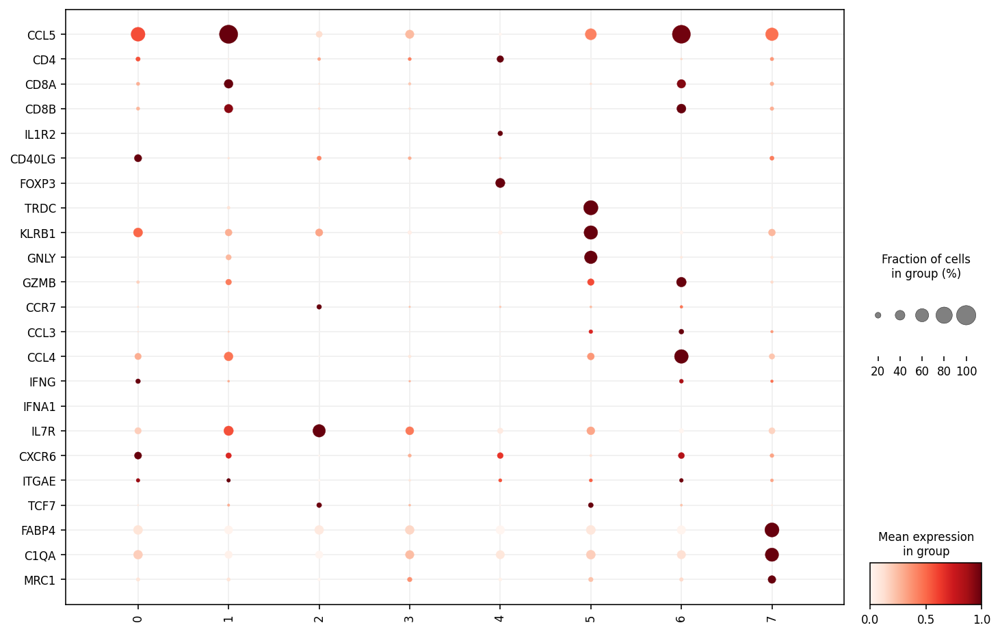

In [ ]:
ax = sc.pl.dotplot(
    cl1,
    ["CCL5", "CD4", "CD8A", "CD8B", "IL1R2", "CD40LG", "FOXP3", "TRDC", "KLRB1", "GNLY", "GZMB",
     "CCR7", "CCL3", "CCL4", "IFNG", "IFNA1", "IL7R", "CXCR6", "ITGAE", "TCF7",
     'FABP4', 'C1QA', 'MRC1'],
    "leiden",
    swap_axes=True,
    figsize=(12, 8),
    standard_scale="var",
    edgecolor=None,
    show=False,
    zorder=2
)
ax["mainplot_ax"].grid(c="#eeeeee", zorder=0)

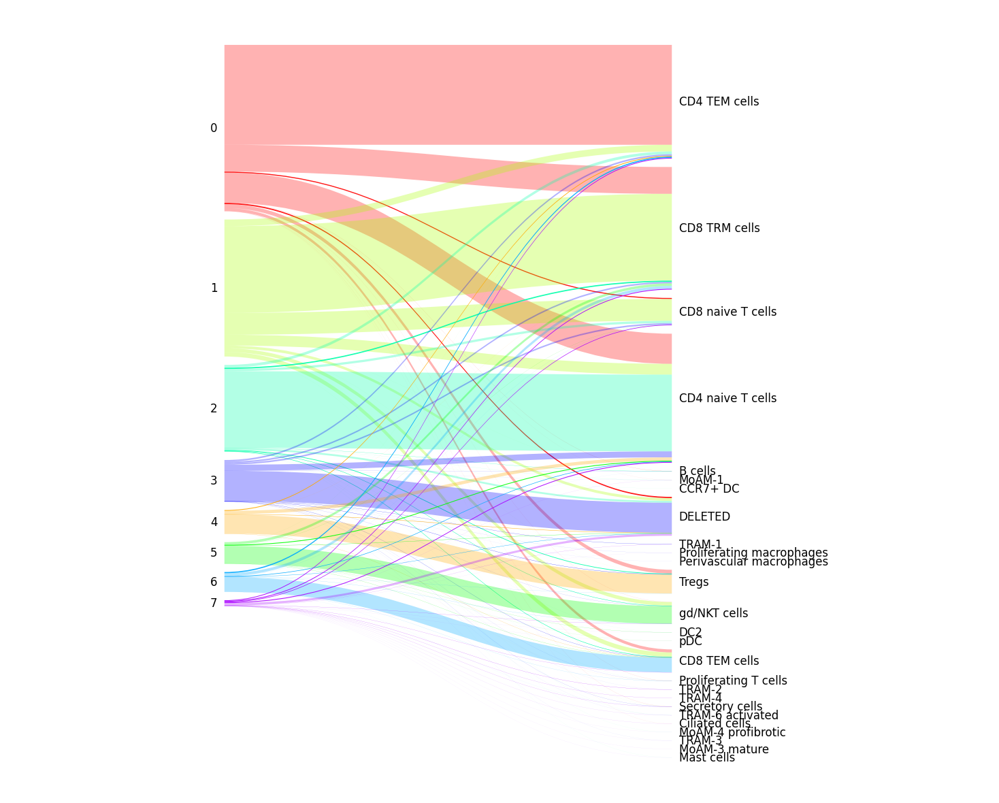

In [54]:
sankey.sankey(cl1.obs.leiden, adata_30[cl1.obs_names]);

In [55]:
adata.shape

(201322, 1000)

In [56]:
adata = adata[~adata.obs_names.isin(cl1.obs_names[cl1.obs.leiden.isin(['3', '7'])]), :].copy()

In [57]:
adata.shape

(199039, 1000)

In [58]:
names = {
    '0': 'CD4 TEM cells',
    '1': 'CD8 TRM cells',
    '2': 'CD4 naive T cells',
    '4': 'Tregs',
    '5': 'gd/NKT cells',
    '6': 'CD8 TEM cells',
}

In [59]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype(str)

In [60]:
for k, v in names.items():
    adata.obs.loc[cl1.obs_names[cl1.obs.leiden.eq(k)], "leiden_scVI"] = v

In [61]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype("category")

<AxesSubplot:title={'center':'leiden_scVI'}, xlabel='UMAP1', ylabel='UMAP2'>

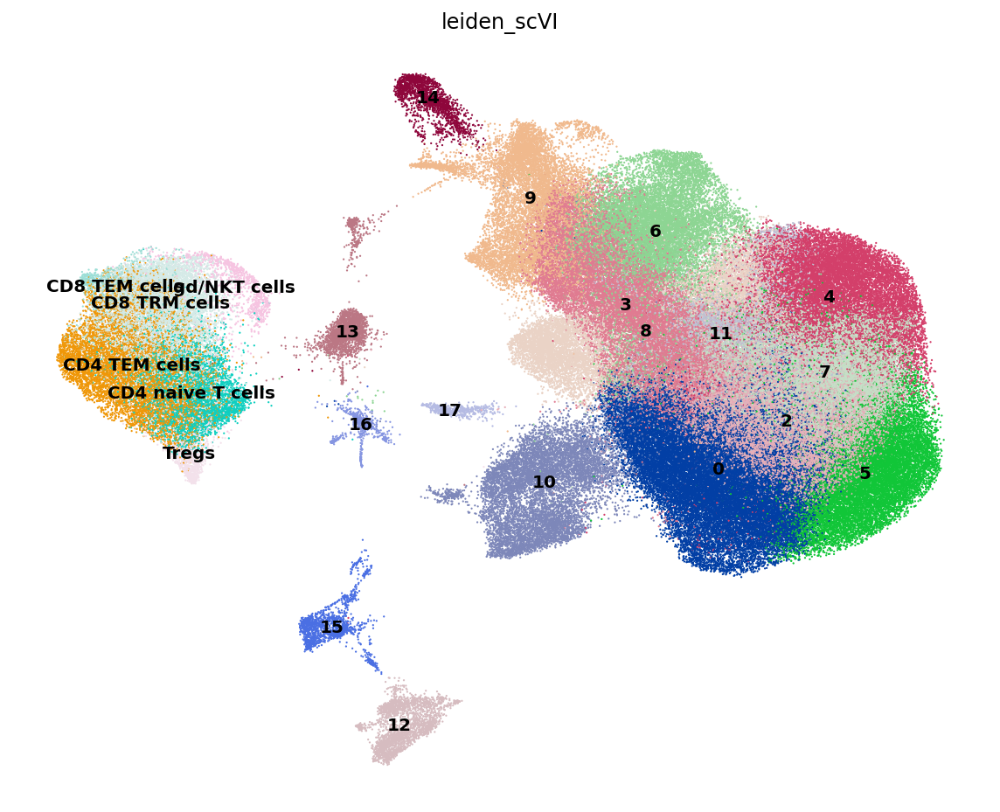

In [ ]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

In [63]:
adata_raw = adata_raw[adata_raw.obs_names.isin(adata.obs_names), :].copy()

# 3. Recluster DCs

In [64]:
dcs = adata_raw[adata.obs.leiden_scVI.eq('9'), :].copy()

In [65]:
sc.pp.highly_variable_genes(
    dcs,
    layer="counts",
    flavor="seurat_v3",
    n_top_genes=100,
    span=0.8,
    subset=True,
    batch_key="Patient"
)

In [66]:
scvi.model.SCVI.setup_anndata(
    dcs,
    layer="counts",
    batch_key="Patient",
    categorical_covariate_keys=["Chemistry"]
)

INFO     Using batches from adata.obs["Patient"]                                             
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 10705 cells, 100 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [67]:
dcs_model = scvi.model.SCVI(dcs, n_layers=2, dropout_rate=0.2, n_latent=10)

In [68]:
model_cache = "models/03_dcs-100hvg.model"
if os.path.exists(model_cache):
    dcs_model = scvi.model.SCVI.load(model_cache, dcs)
else:
    dcs_model.train(
        max_epochs=400,
        use_gpu=True,
        check_val_every_n_epoch=2,
        early_stopping=True
    )
    dcs_model.save(model_cache)

INFO     Using data from adata.layers["counts"]                                              
INFO     Registered keys:['X', 'batch_indices', 'labels', 'cat_covs']                        
INFO     Successfully registered anndata object containing 10705 cells, 100 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              


/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/venv/lib/python3.9/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function transfer_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.
  warnings.warn(msg, category=FutureWarning)


In [69]:
dcs.obsm["X_scVI"] = dcs_model.get_latent_representation()

In [70]:
sc.pp.neighbors(dcs, use_rep="X_scVI")
sc.tl.umap(dcs, min_dist=0.3)

In [71]:
sc.tl.leiden(dcs, resolution=0.31)

<AxesSubplot:title={'center':'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>

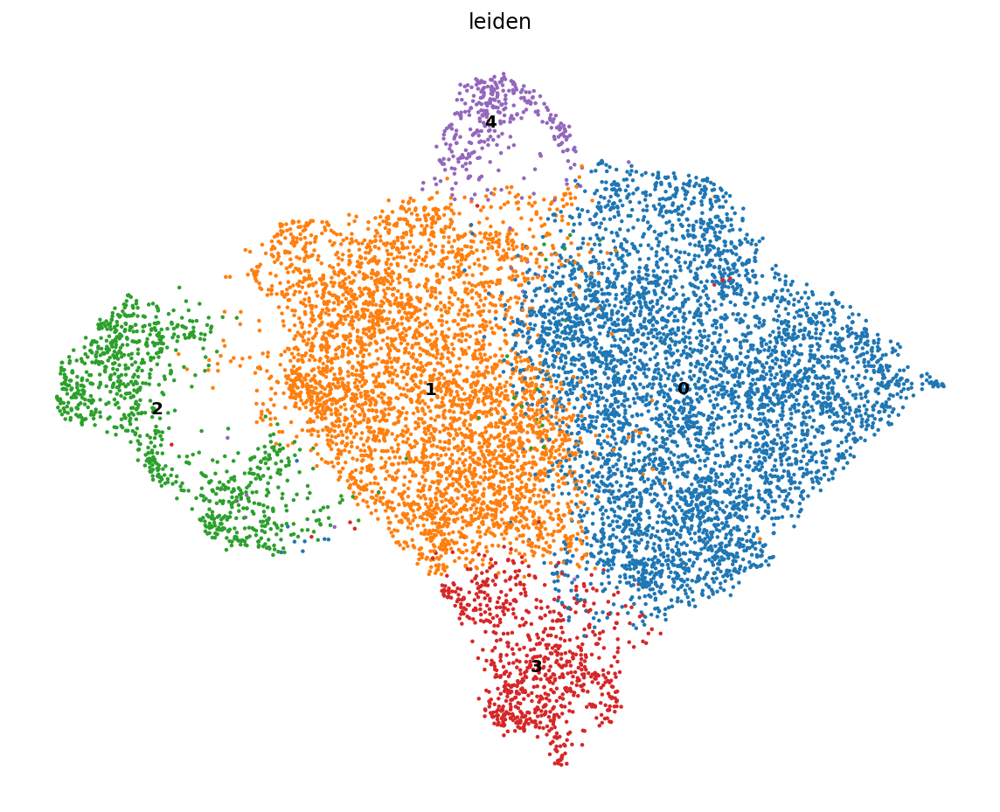

In [ ]:
sc.pl.umap(
    dcs,
    color=["leiden"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=20
)

In [73]:
sc.tl.rank_genes_groups(dcs, "leiden", method="t-test", n_genes=200)

In [74]:
markers_dcs = sc_utils.get_markers(dcs, "leiden")

In [75]:
markers_dcs.cluster = markers_dcs.cluster.astype(int)

In [76]:
markers_dcs.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [77]:
markers_dcs.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
194,1.986579e-47,4.875388,0.054438,0.002841,1.986579e-47,0,NRG1
175,2.282517e-53,4.673380,0.069265,0.004512,2.282517e-53,0,CCL7
40,6.759402e-140,4.614571,0.166914,0.012199,6.759402e-140,0,S100A12
86,4.082808e-90,4.067544,0.115653,0.011029,4.082808e-90,0,APOBEC3A
1,0.000000e+00,3.641165,0.723787,0.250000,0.000000e+00,0,S100A8
219,1.353334e-212,3.506395,0.319737,0.044244,1.353334e-212,1,CD1A
207,0.000000e+00,3.452439,0.610590,0.198727,0.000000e+00,1,CCL17
203,0.000000e+00,3.346603,0.654928,0.173720,0.000000e+00,1,CD1C
310,3.037698e-78,2.785228,0.153028,0.028115,3.037698e-78,1,C12orf75
209,0.000000e+00,2.737027,0.558399,0.161734,0.000000e+00,1,CD1E


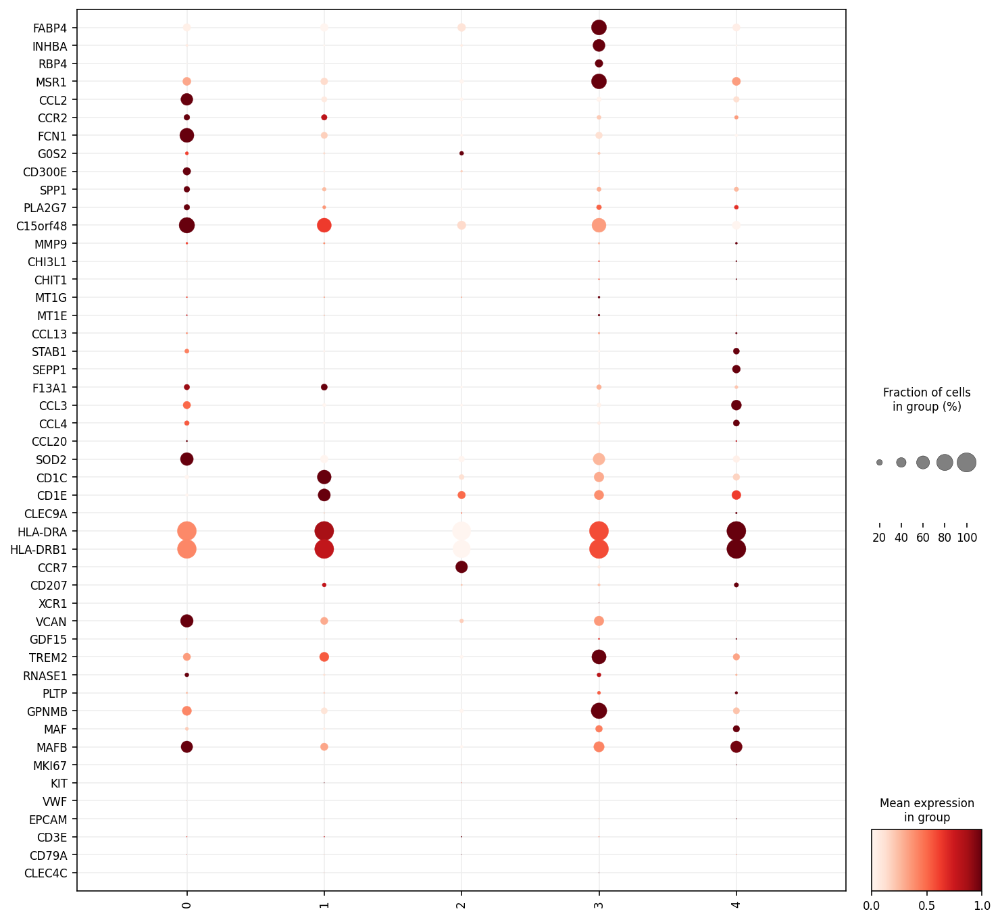

In [78]:
ax = sc.pl.dotplot(
    dcs,
    ["FABP4", "INHBA", "RBP4", "MSR1", "CCL2", "CCR2", "FCN1", "G0S2", "CD300E", # TRAM + MoAM + mono
     "SPP1", "PLA2G7", "C15orf48", "MMP9", "CHI3L1", "CHIT1", # profibrotic
     "MT1G", "MT1E", "CCL13", "STAB1", "SEPP1", "F13A1", # perivascular
     "CCL3", "CCL4", "CCL20", "SOD2", # activated
     "CD1C", "CD1E", "CLEC9A", "HLA-DRA", "HLA-DRB1", "CCR7", "CD207", "XCR1", # DC1/2
     "VCAN", "GDF15", "TREM2", "RNASE1", "PLTP", "GPNMB", "MAF", "MAFB", "MKI67",
     'KIT', 'VWF', 'EPCAM', 'CD3E', 'CD79A', 'CLEC4C'
    ], # misc
    "leiden",
    swap_axes=True,
    figsize=(12, 12),
    standard_scale="var",
    edgecolor=None,
    show=False,
    zorder=2
)
ax["mainplot_ax"].grid(c="#eeeeee", zorder=0)

<AxesSubplot:title={'center':'Leiden by Patient'}>

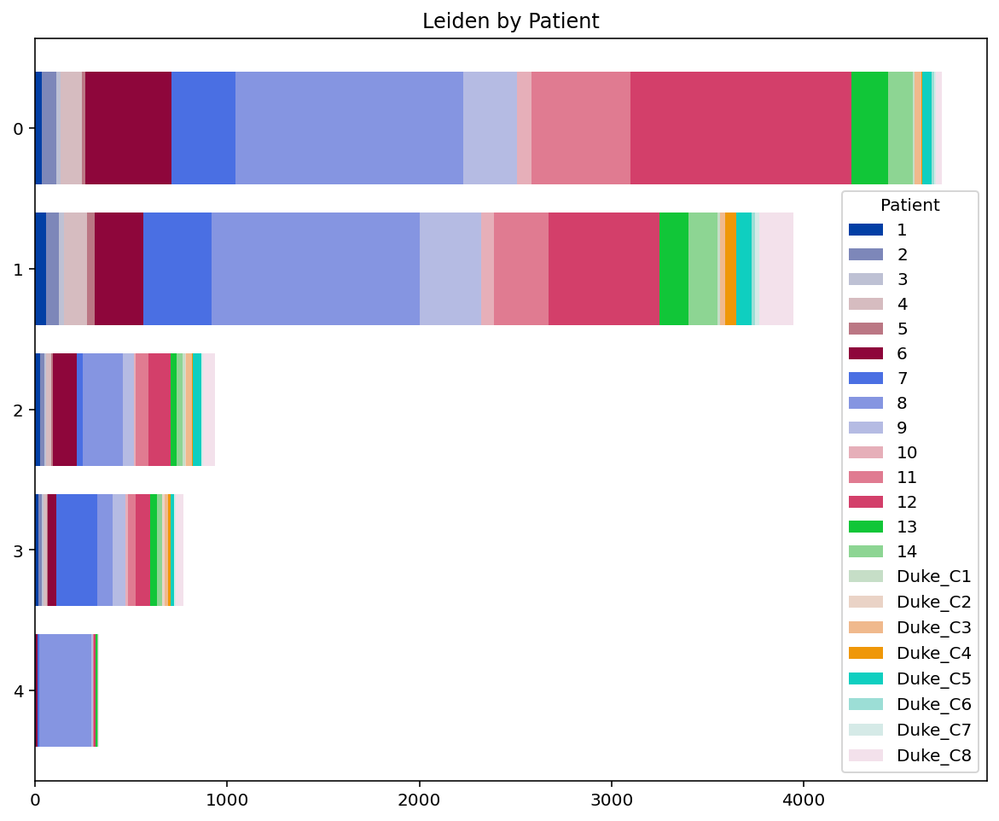

In [80]:
sc_utils.plot_composition(dcs, group_by="leiden", color="Patient")

Cluster 4 comes from single patient, exclude

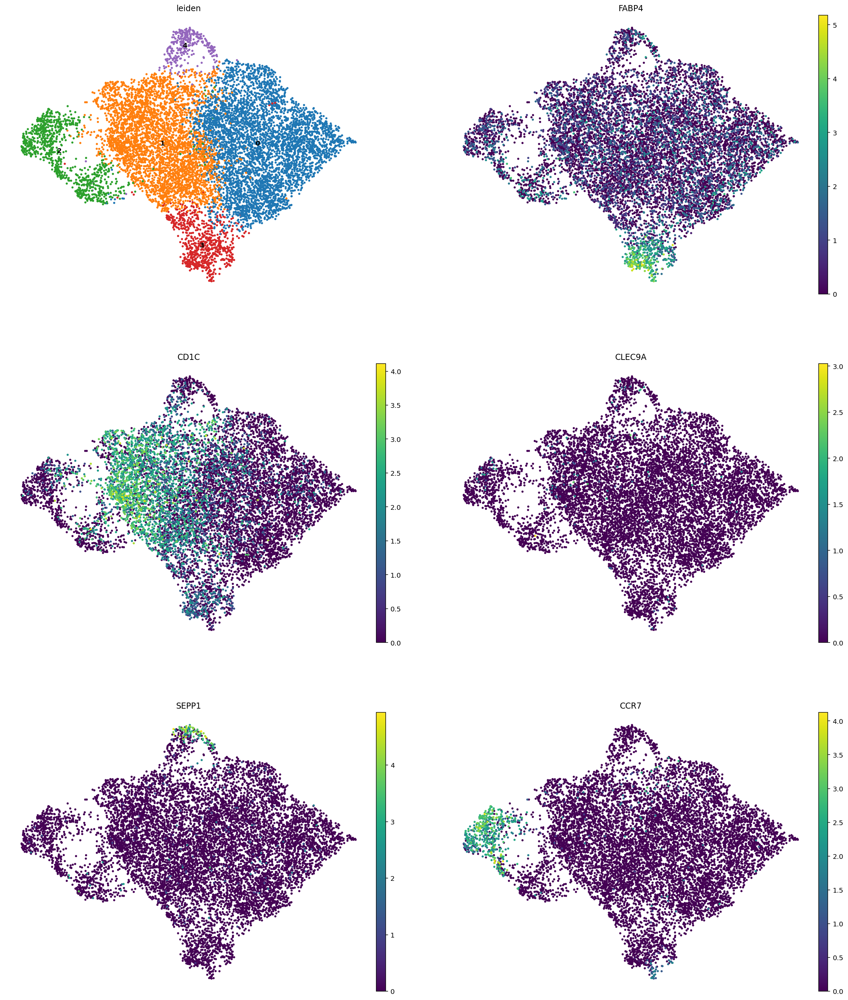

In [ ]:
sc.pl.umap(
    dcs,
    color=["leiden", "FABP4", "CD1C", "CLEC9A", "SEPP1", "CCR7"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=40,
    ncols=2
);

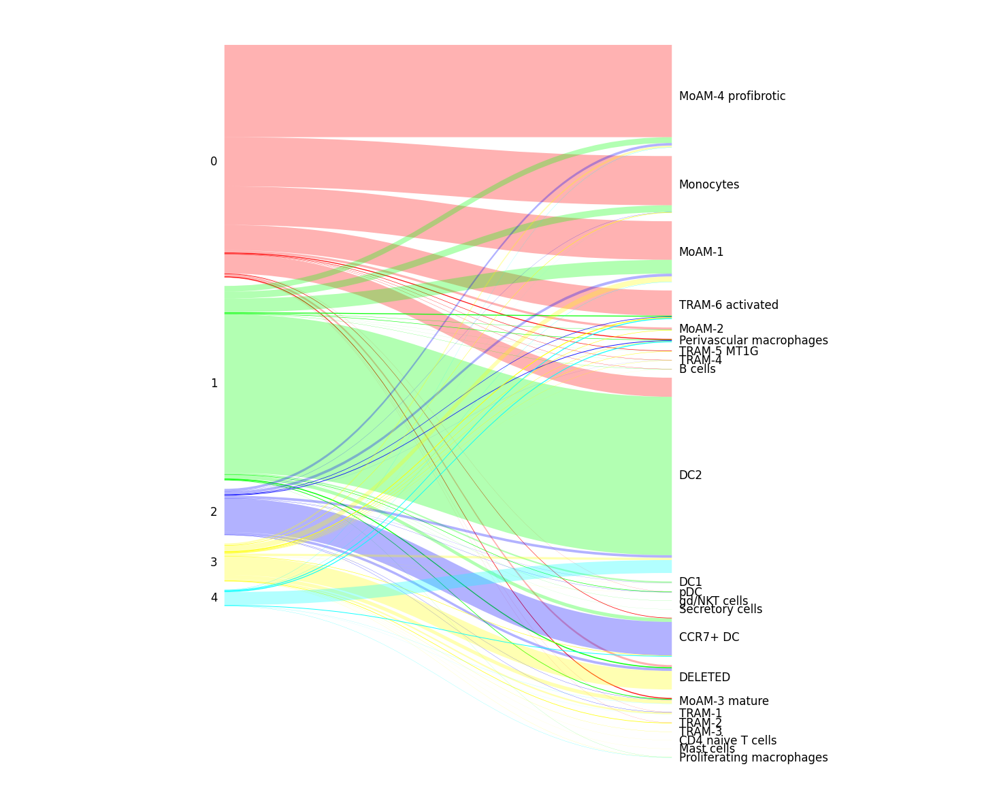

In [82]:
sankey.sankey(dcs.obs.leiden, adata_30[dcs.obs_names]);

Cluster 3—legitimate doublets

Cluster 0—MoAM

Cluster 1—DC2

Cluster 2—CCR7+ DC

Cluster 4—strange DC2 with SEPP1, from single patient, exclude

In [83]:
adata.shape

(199039, 1000)

In [84]:
adata = adata[~adata.obs_names.isin(dcs.obs_names[dcs.obs.leiden.isin(['3', '4'])]), :].copy()

In [85]:
adata.shape

(197939, 1000)

In [86]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype(str)

In [87]:
adata.obs.loc[dcs.obs_names[dcs.obs.leiden.isin(["0"])], "leiden_scVI"] = "MoAM"

In [88]:
adata.obs.loc[dcs.obs_names[dcs.obs.leiden.isin(["1"])], "leiden_scVI"] = "DC2"

In [89]:
adata.obs.loc[dcs.obs_names[dcs.obs.leiden.isin(["2"])], "leiden_scVI"] = "CCR7+ DC"

In [90]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype("category")

<AxesSubplot:title={'center':'leiden_scVI'}, xlabel='UMAP1', ylabel='UMAP2'>

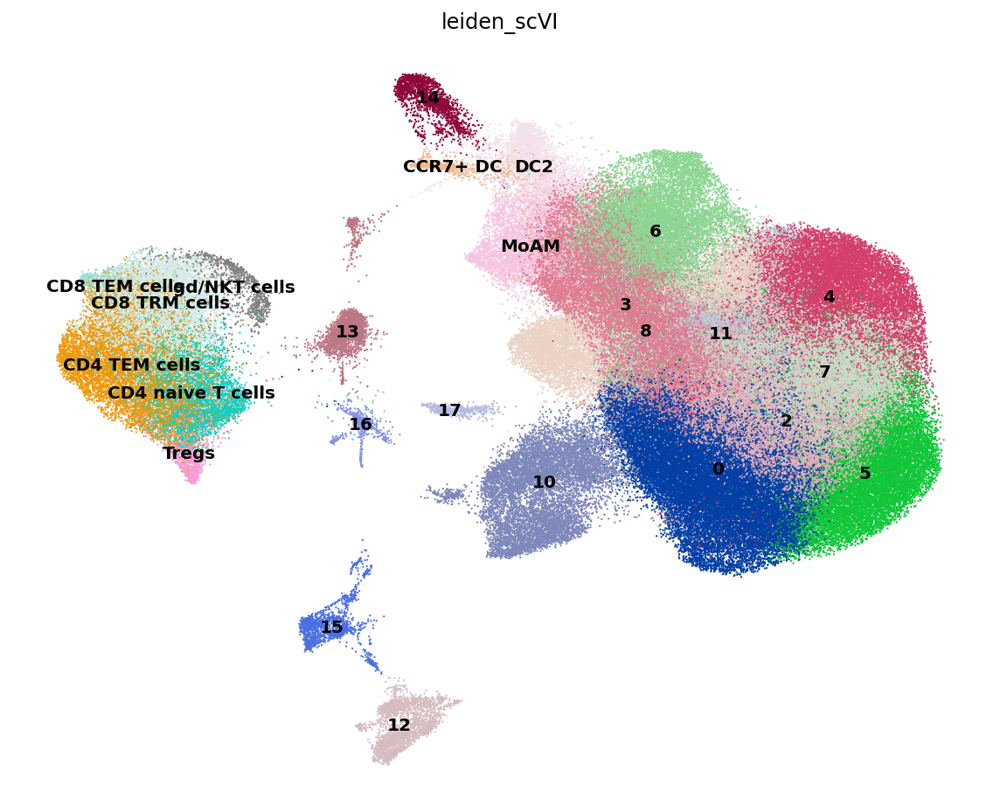

In [ ]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

In [92]:
adata_raw = adata_raw[adata_raw.obs_names.isin(adata.obs_names), :].copy()

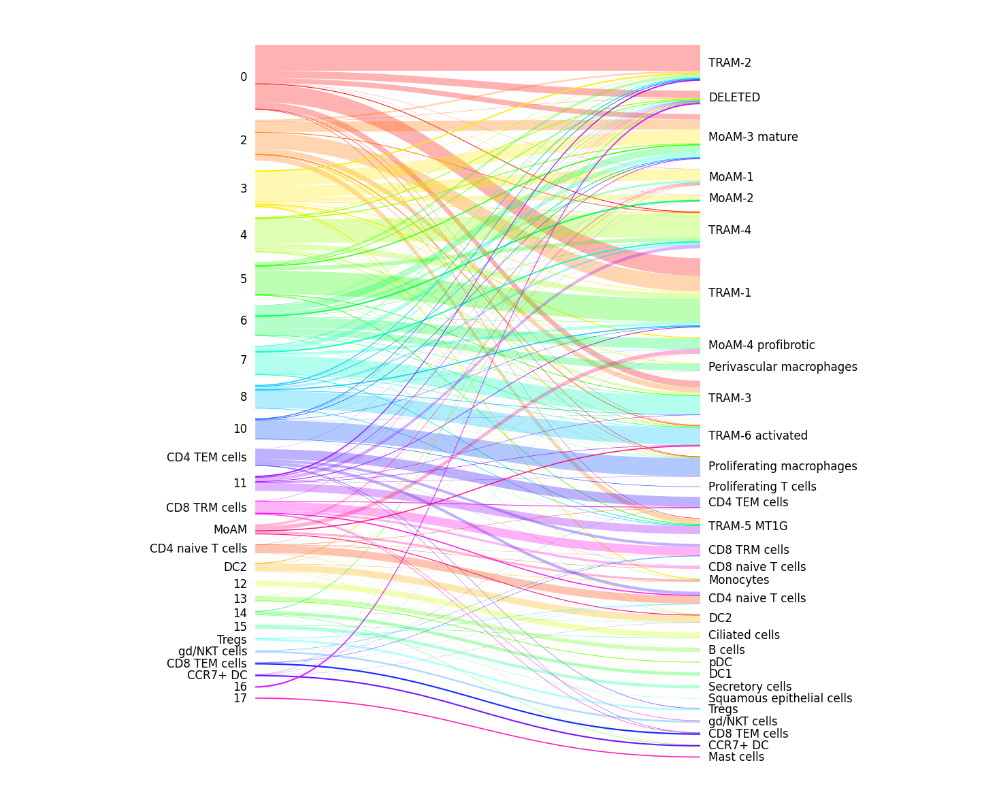

In [93]:
sankey.sankey(adata.obs.leiden_scVI, adata_30[adata.obs_names]);

# 4. Recluster MoAM

In [94]:
moam = adata_raw[adata.obs.leiden_scVI.isin(['3', '6', 'MoAM']), :].copy()

In [95]:
sc.pp.highly_variable_genes(
    moam,
    layer="counts",
    flavor="seurat_v3",
    n_top_genes=100,
    span=0.5,
    subset=True,
    batch_key="Patient"
)

In [96]:
scvi.model.SCVI.setup_anndata(
    moam,
    layer="counts",
    batch_key="Patient",
    categorical_covariate_keys=["Chemistry"]
)

INFO     Using batches from adata.obs["Patient"]                                             
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 36599 cells, 100 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [97]:
moam_model = scvi.model.SCVI(moam, n_layers=2, dropout_rate=0.2, n_latent=10)

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/venv/lib/python3.9/site-packages/scvi/model/_utils.py:272: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  warnings.warn(


In [98]:
model_cache = "models/03_moam-100hvg.model"
if os.path.exists(model_cache):
    moam_model = scvi.model.SCVI.load(model_cache, moam)
else:
    moam_model.train(
        max_epochs=400,
        use_gpu=True,
        check_val_every_n_epoch=2,
        early_stopping=True
    )
    moam_model.save(model_cache)

INFO     Using data from adata.layers["counts"]                                              
INFO     Registered keys:['X', 'batch_indices', 'labels', 'cat_covs']                        
INFO     Successfully registered anndata object containing 36599 cells, 100 vars, 22 batches,
         1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 0 extra
         continuous covariates.                                                              


/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/venv/lib/python3.9/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function transfer_anndata_setup is deprecated; This method will be removed in 0.15.0. Please avoid building any new dependencies on it.
  warnings.warn(msg, category=FutureWarning)


In [99]:
moam.obsm["X_scVI"] = moam_model.get_latent_representation()

In [100]:
sc.pp.neighbors(moam, use_rep="X_scVI")
sc.tl.umap(moam, min_dist=0.3)

In [101]:
sc.tl.leiden(moam, resolution=0.5)

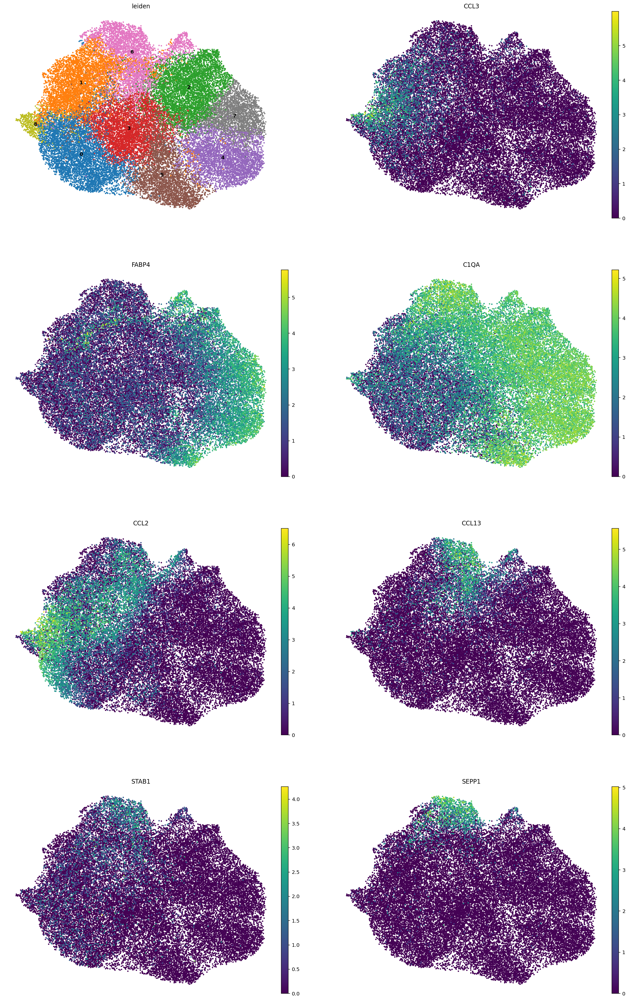

In [ ]:
sc.pl.umap(
    moam,
    color=["leiden", "CCL3", "FABP4", "C1QA", "CCL2", "CCL13", "STAB1", "SEPP1"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=30,
    ncols=2
);

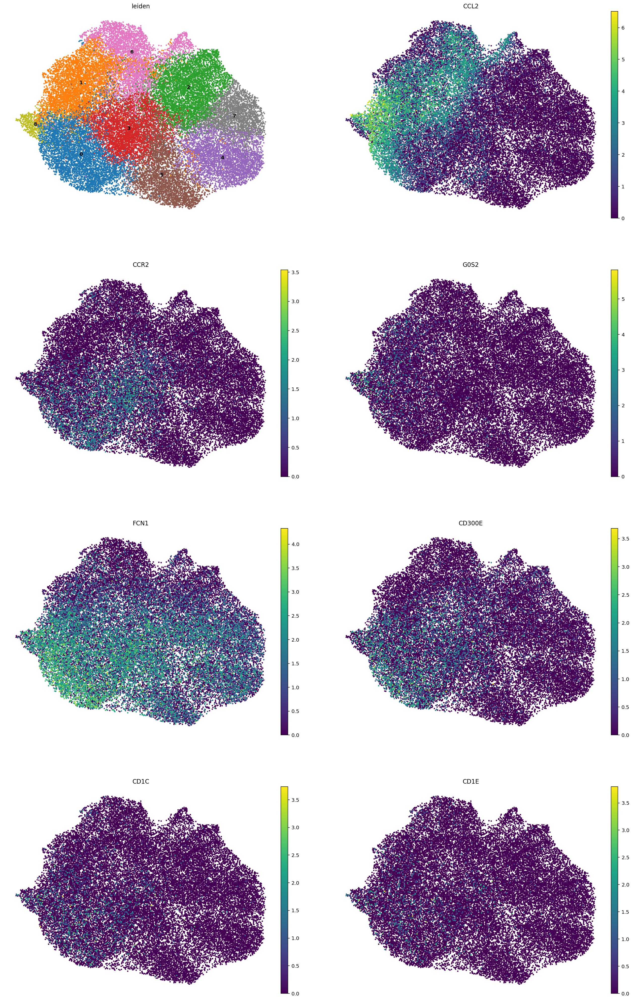

In [ ]:
sc.pl.umap(
    moam,
    color=["leiden", "CCL2", "CCR2", "G0S2", "FCN1", "CD300E", "CD1C", "CD1E"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=30,
    ncols=2
);

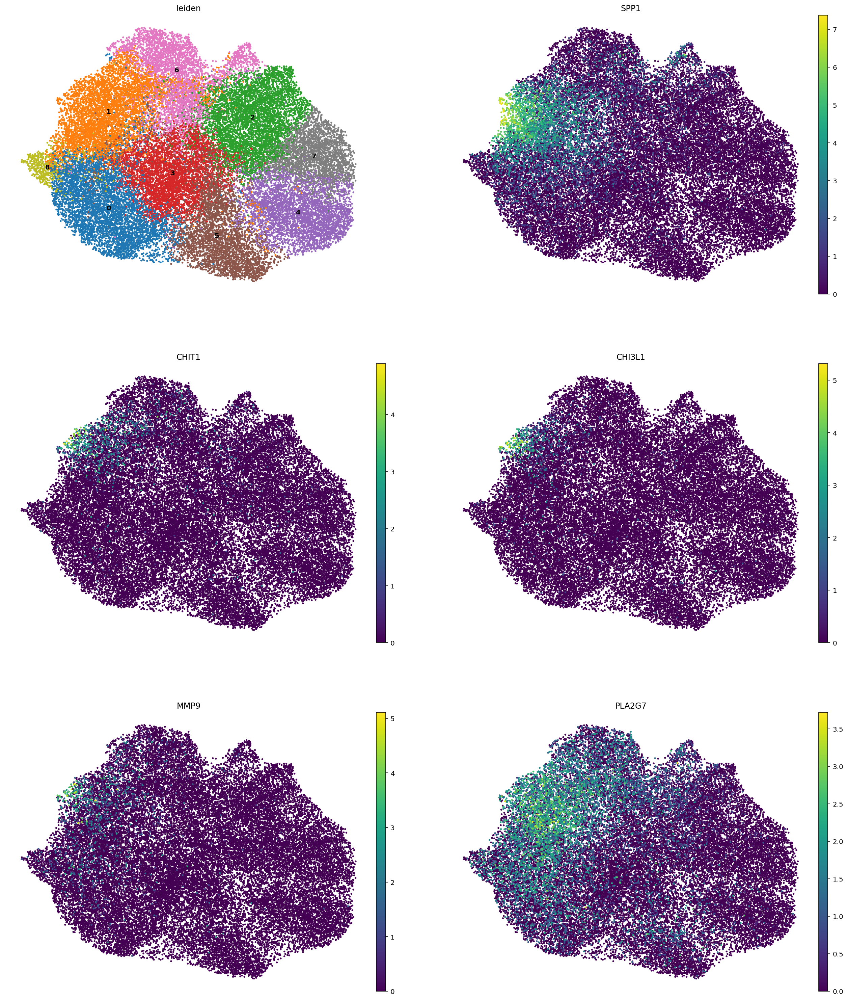

In [ ]:
sc.pl.umap(
    moam,
    color=["leiden", "SPP1", "CHIT1", "CHI3L1", "MMP9", "PLA2G7"],
    frameon=False,
    legend_loc="on data",
    show=False,
    size=30,
    ncols=2
);

<AxesSubplot:title={'center':'Leiden by Patient'}>

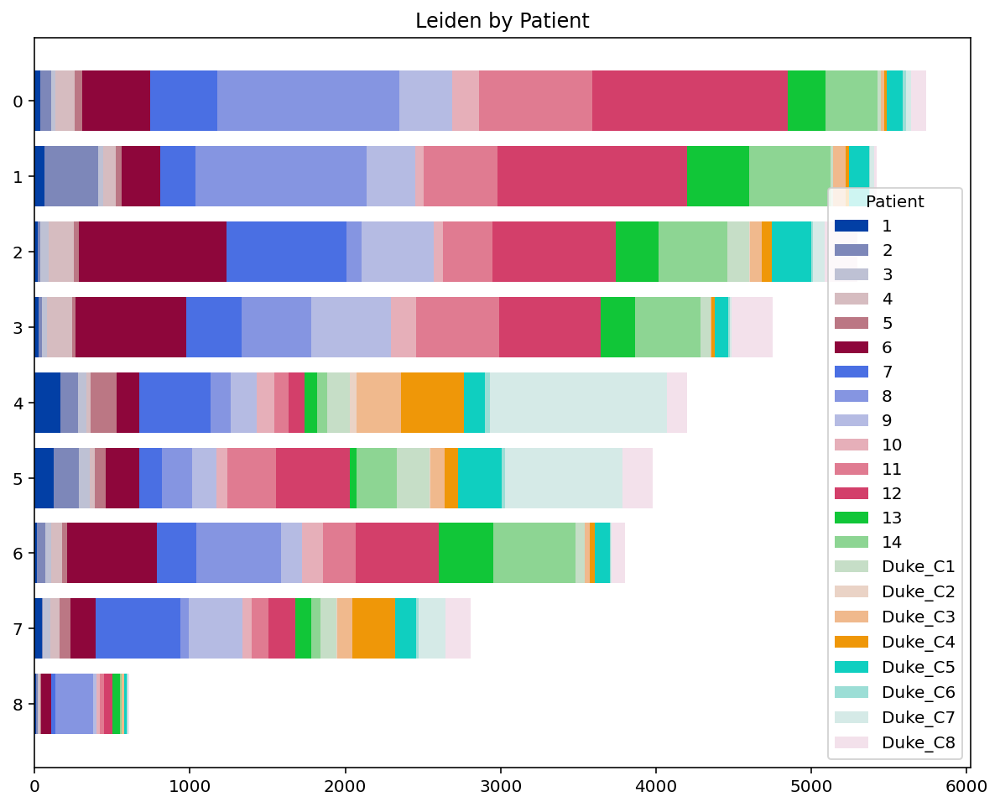

In [105]:
sc_utils.plot_composition(moam, group_by="leiden", color="Patient")

<AxesSubplot:title={'center':'Leiden by Study'}>

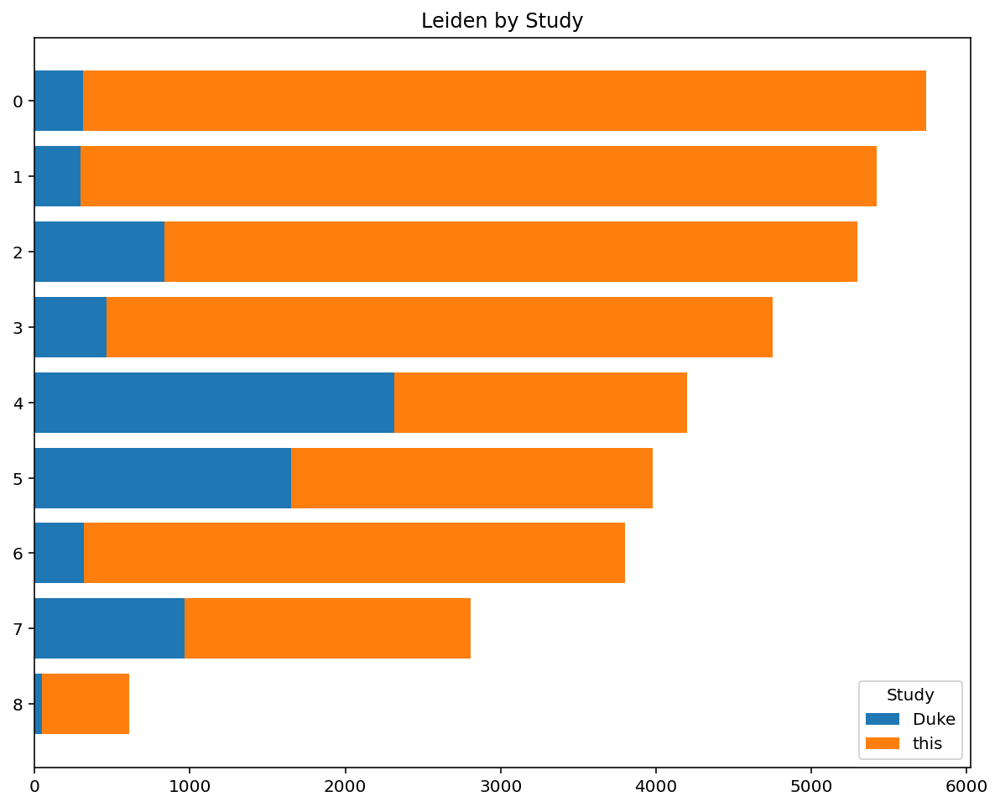

In [106]:
sc_utils.plot_composition(moam, group_by="leiden", color="Study")

<AxesSubplot:title={'center':'Leiden by Chemistry'}>

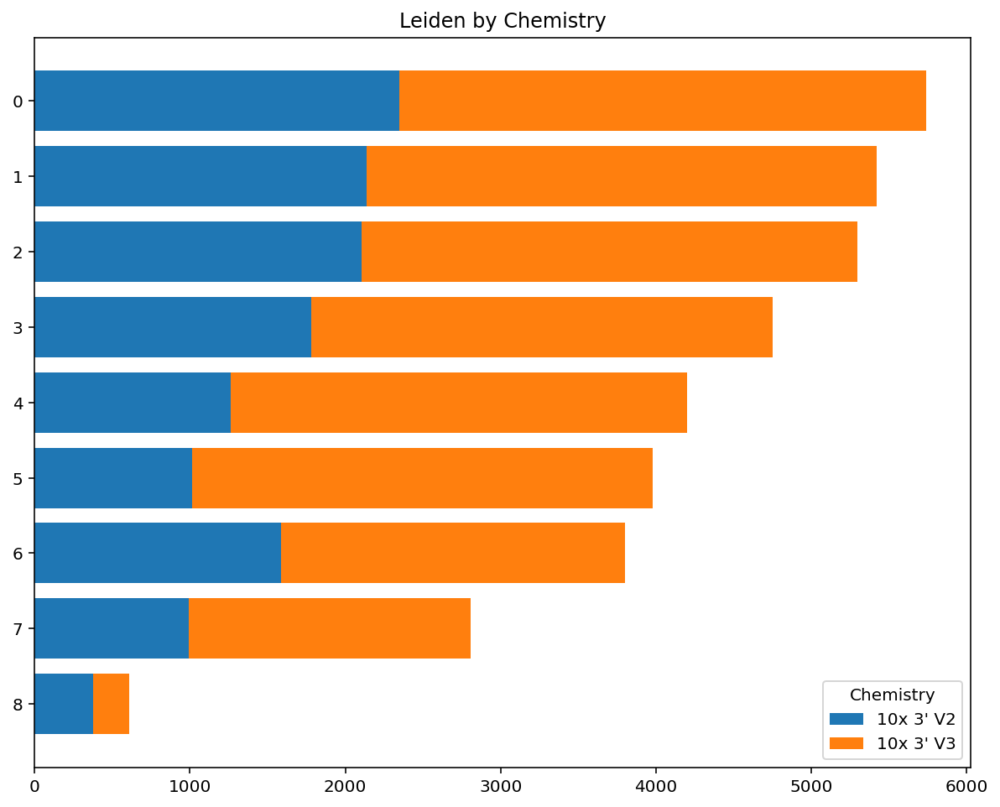

In [107]:
sc_utils.plot_composition(moam, group_by="leiden", color="Chemistry")

<AxesSubplot:title={'center':'Leiden by Status'}>

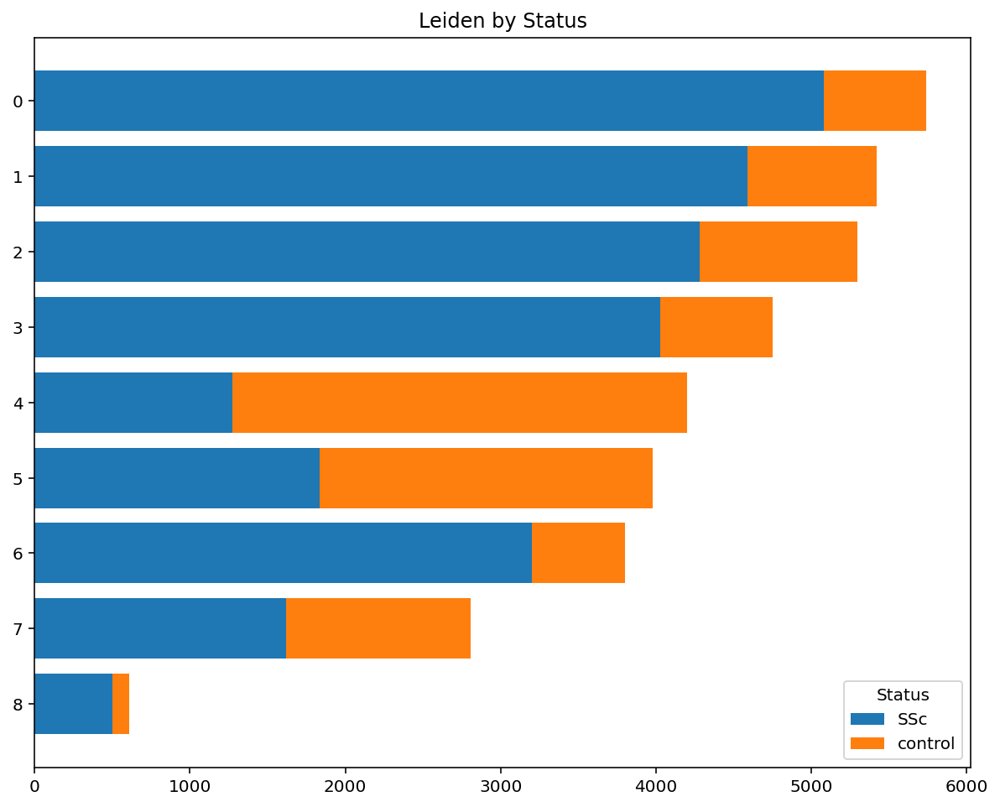

In [108]:
sc_utils.plot_composition(moam, group_by="leiden", color="Status")

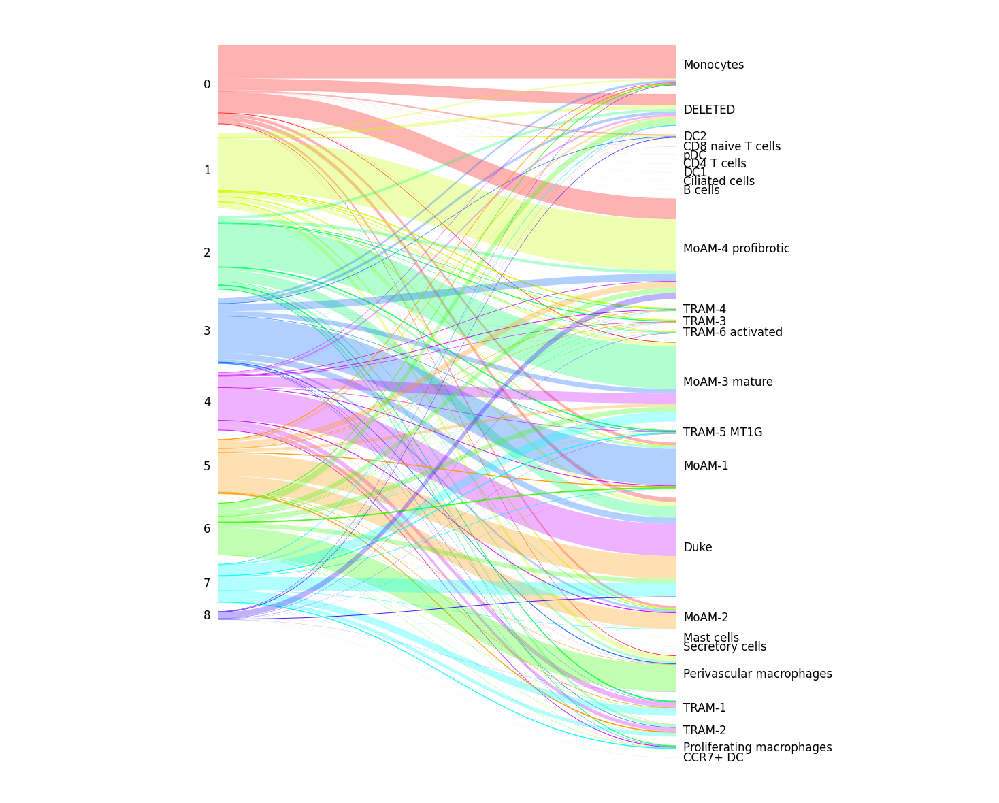

In [109]:
sankey.sankey(moam.obs.leiden, prev_ct[moam.obs_names]);

In [110]:
sc.tl.rank_genes_groups(moam, "leiden", method="t-test", n_genes=200)

In [111]:
markers_moam = sc_utils.get_markers(moam, "leiden")

In [112]:
markers_moam.cluster = markers_moam.cluster.astype(int)

In [113]:
markers_moam.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [114]:
markers_moam.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
46,3.269980e-116,3.530235,0.126655,0.017013,3.269980e-116,0,S100A12
186,3.141278e-44,3.457111,0.046864,0.005477,3.141278e-44,0,NRG1
112,2.200266e-67,2.718011,0.081882,0.015004,2.200266e-67,0,ADAM19
25,1.318948e-158,2.656931,0.193206,0.044493,1.318948e-158,0,MARCKSL1
37,1.343961e-126,2.346585,0.167770,0.044395,1.343961e-126,0,PID1
332,1.200956e-89,4.662366,0.110722,0.008275,1.200956e-89,1,CHI3L1
394,4.931828e-68,4.603852,0.075106,0.003560,4.931828e-68,1,HS3ST2
203,0.000000e+00,4.601034,0.541428,0.106511,0.000000e+00,1,SPP1
285,1.388817e-119,4.295631,0.137848,0.012540,1.388817e-119,1,CHIT1
304,8.645502e-103,3.717574,0.124562,0.011514,8.645502e-103,1,TM4SF19


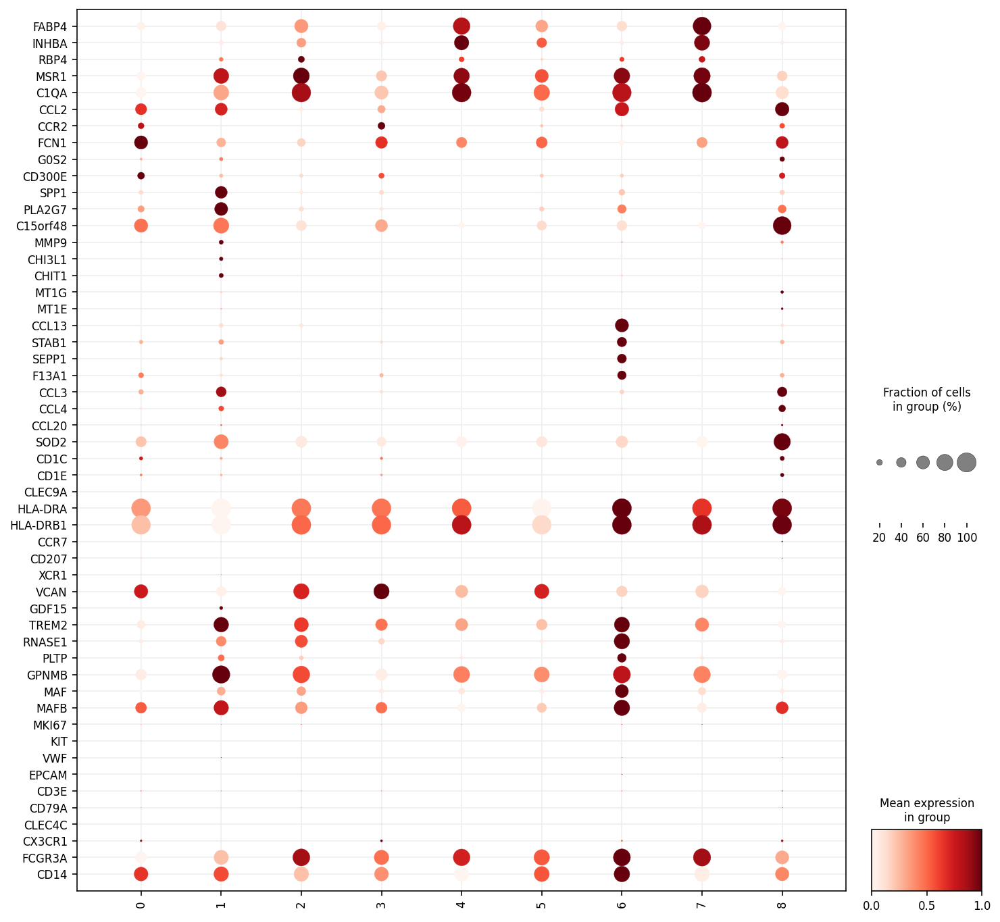

In [115]:
ax = sc.pl.dotplot(
    moam,
    ["FABP4", "INHBA", "RBP4", "MSR1", 'C1QA', "CCL2", "CCR2", "FCN1", "G0S2", "CD300E", # TRAM + MoAM + mono
     "SPP1", "PLA2G7", "C15orf48", "MMP9", "CHI3L1", "CHIT1", # profibrotic
     "MT1G", "MT1E", "CCL13", "STAB1", "SEPP1", "F13A1", # perivascular
     "CCL3", "CCL4", "CCL20", "SOD2", # activated
     "CD1C", "CD1E", "CLEC9A", "HLA-DRA", "HLA-DRB1", "CCR7", "CD207", "XCR1", # DC1/2
     "VCAN", "GDF15", "TREM2", "RNASE1", "PLTP", "GPNMB", "MAF", "MAFB", "MKI67",
     'KIT', 'VWF', 'EPCAM', 'CD3E', 'CD79A', 'CLEC4C', 'CX3CR1', 'FCGR3A', 'CD14',
    ], # misc
    "leiden",
    swap_axes=True,
    figsize=(12, 12),
    standard_scale="var",
    edgecolor=None,
    show=False,
    zorder=2
)
ax["mainplot_ax"].grid(c="#eeeeee", zorder=0)

<AxesSubplot:xlabel='leiden', ylabel='total_counts'>

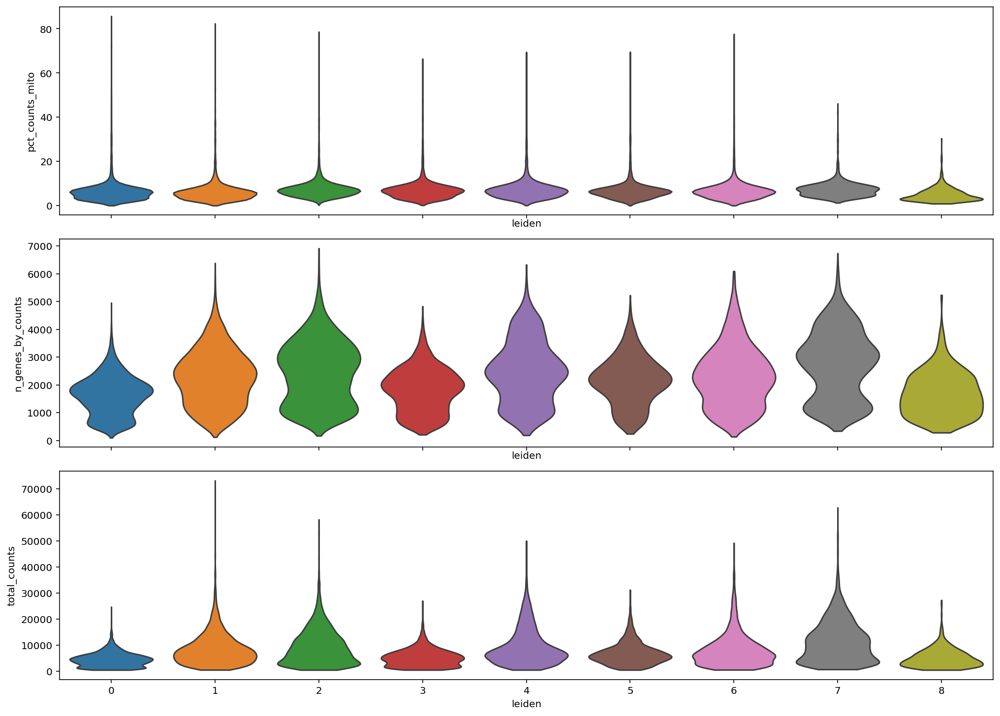

In [116]:
fig, ax = plt.subplots(nrows=3, figsize=(14, 10), constrained_layout=True, sharex=True)

sc.pl.violin(moam, "pct_counts_mito", groupby="leiden", ax=ax[0], show=False, size=0)
sc.pl.violin(moam, "n_genes_by_counts", groupby="leiden", ax=ax[1], show=False, size=0)
sc.pl.violin(moam, "total_counts", groupby="leiden", ax=ax[2], show=False, size=0)

In [117]:
pd.Series(    ["FABP4", "INHBA", "RBP4", "MSR1", "CCL2", "CCR2", "FCN1", "G0S2", # TRAM + MoAM + mono
     "SPP1", "PLA2G7", "C15orf48", "MMP9", "CHI3L1", "CHIT1", # profibrotic
     "MT1G", "MT1E", "CCL13", "STAB1", "SEPP1", "F13A1", # perivascular
     "CCL3", "CCL4", "CCL20", "SOD2", # activated
     "CD1C", "CD1E", "CLEC9A", "HLA-DRA", "HLA-DRB1", "CCR7", "CD207", "XCR1", # DC1/2
     "VCAN", "GDF15", "TREM2", "RNASE1", "PLTP", "GPNMB", "MAF", "MAFB", "MKI67"], # misc
).isin(moam.var_names).sum()

17

In [118]:
pd.Series(    ["FABP4", "INHBA", "RBP4", "MSR1", "CCL2", "CCR2", "FCN1", "G0S2", # TRAM + MoAM + mono
     "SPP1", "PLA2G7", "C15orf48", "MMP9", "CHI3L1", "CHIT1", # profibrotic
     "MT1G", "MT1E", "CCL13", "STAB1", "SEPP1", "F13A1", # perivascular
     "CCL3", "CCL4", "CCL20", "SOD2", # activated
     "CD1C", "CD1E", "CLEC9A", "HLA-DRA", "HLA-DRB1", "CCR7", "CD207", "XCR1", # DC1/2
     "VCAN", "GDF15", "TREM2", "RNASE1", "PLTP", "GPNMB", "MAF", "MAFB"], # misc
).size

40

In [119]:
names = """
0: Monocytes
1: MoAM-4 profibrotic
2: MoAM-3 mature
3: MoAM-1
4: MoAM-3 mature
5: MoAM-3 mature
6: Perivascular macrophages
7: MoAM-3 mature
8: Activated monocytes
""".strip().split("\n")

In [120]:
names = {x.split(":")[0].strip() : x.split(":")[1].strip() for x in names}

In [121]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype(str)

In [122]:
for k, v in names.items():
    adata.obs.loc[moam.obs_names[moam.obs.leiden.eq(k)], "leiden_scVI"] = v

In [123]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype("category")

<AxesSubplot:title={'center':'leiden_scVI'}, xlabel='UMAP1', ylabel='UMAP2'>

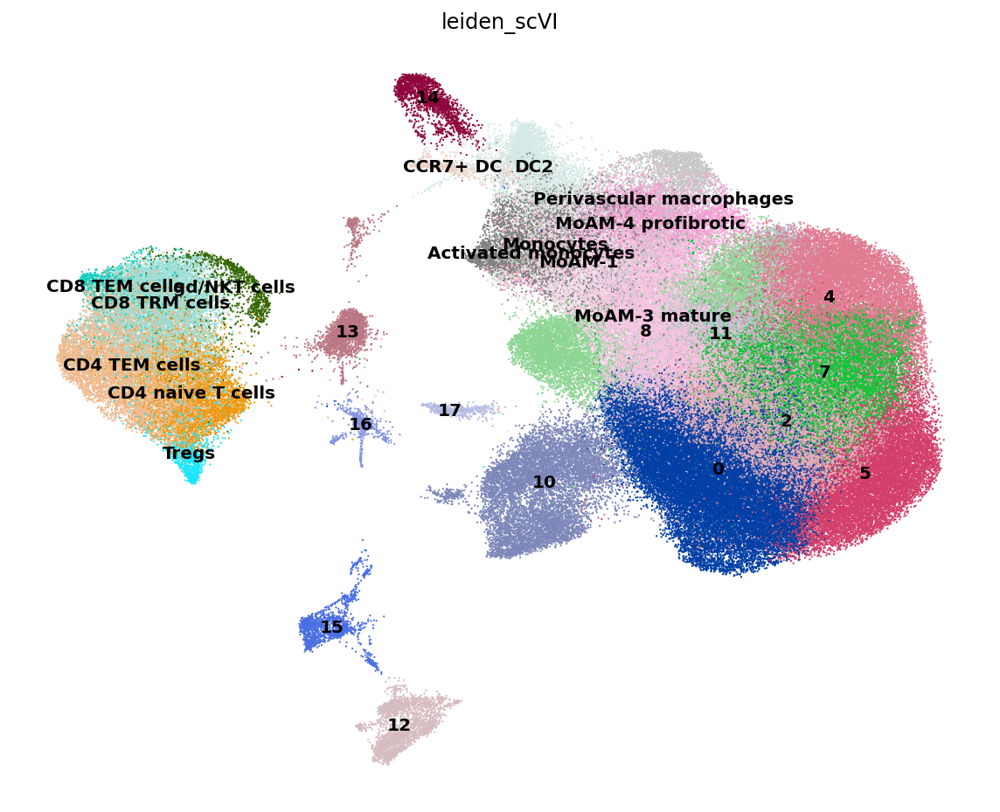

In [ ]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

In [125]:
adata_raw = adata_raw[adata_raw.obs_names.isin(adata.obs_names), :].copy()

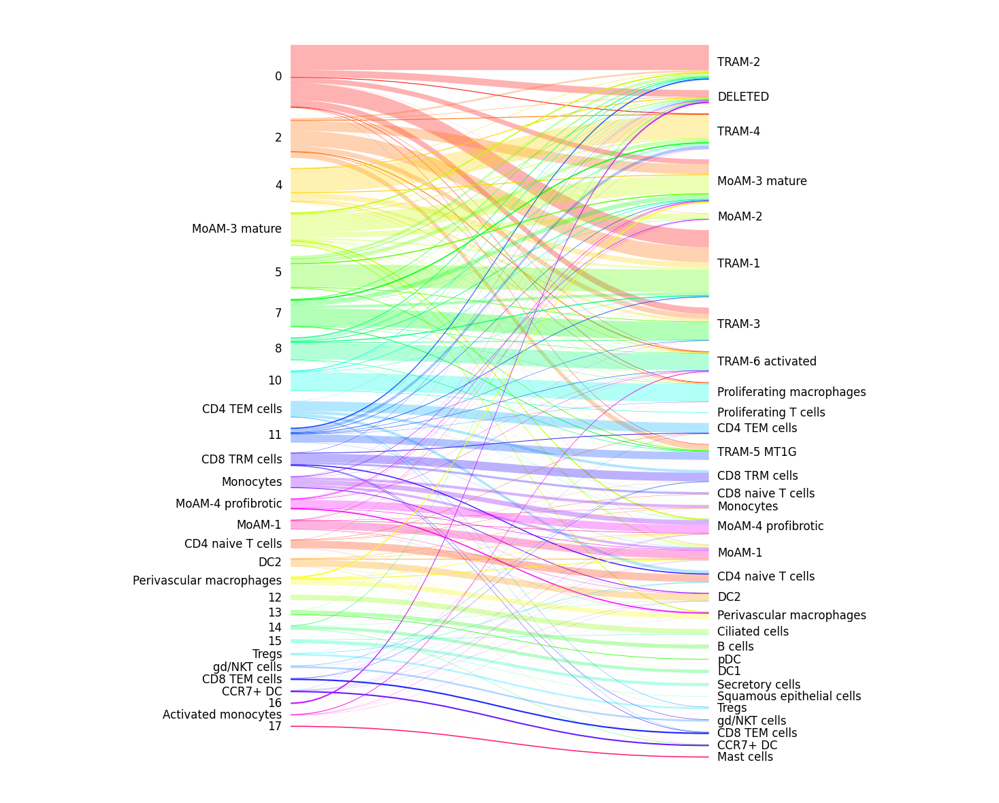

In [126]:
sankey.sankey(adata.obs.leiden_scVI, adata_30[adata.obs_names]);

# 6. Recluster Cluster 13

In [127]:
cl13 = adata[adata.obs.leiden_scVI.eq("13"), :].copy()

In [128]:
sc.tl.leiden(cl13, resolution=0.02)

<AxesSubplot:title={'center':'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>

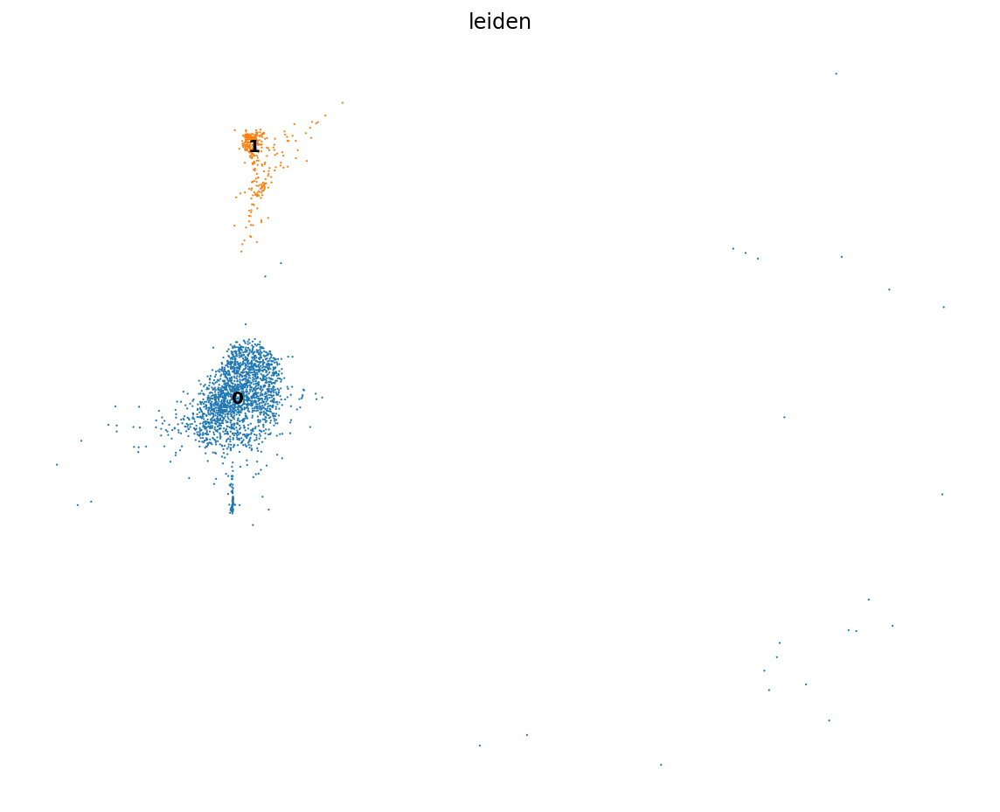

In [ ]:
sc.pl.umap(
    cl13,
    color="leiden",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

In [130]:
sc.tl.rank_genes_groups(cl13, "leiden", method="t-test", n_genes=200)

In [131]:
markers13 = sc_utils.get_markers(cl13, "leiden")

In [132]:
markers13.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [133]:
markers13.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
6,3.763626e-140,29.888208,0.306700,0.000000,3.763626e-140,0,AL928768.3
13,8.853150e-85,29.035967,0.212903,0.000000,8.853150e-85,0,IGHG1
38,1.535637e-47,27.980598,0.114640,0.000000,1.535637e-47,0,VPREB3
28,1.176242e-54,27.959440,0.130521,0.000000,1.176242e-54,0,ZBTB32
26,7.431747e-56,27.858377,0.133499,0.000000,7.431747e-56,0,POU2AF1
200,2.910649e-132,9.665270,0.909938,0.012903,2.910649e-132,1,GZMB
230,5.852359e-49,9.640324,0.577640,0.001985,5.852359e-49,1,SCT
389,5.518543e-17,9.374224,0.239130,0.000993,5.518543e-17,1,PACSIN1
262,1.942331e-34,8.727930,0.440994,0.003474,1.942331e-34,1,PTGDS
219,3.353325e-58,8.402187,0.633540,0.003970,3.353325e-58,1,MAP1A


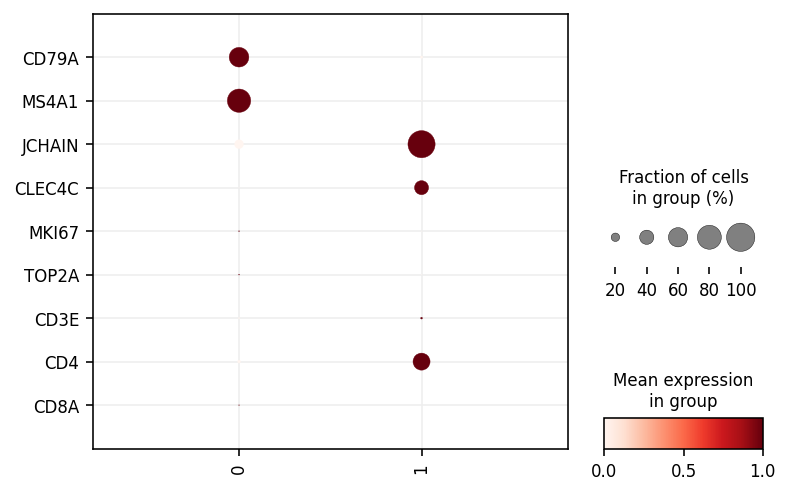

In [134]:
ax = sc.pl.dotplot(
    cl13,
    ["CD79A", "MS4A1", "JCHAIN", "CLEC4C", 'MKI67', 'TOP2A', 'CD3E', 'CD4', 'CD8A'], # misc
    "leiden",
    swap_axes=True,
    figsize=(6, 4),
    standard_scale="var",
    edgecolor=None,
    show=False,
    zorder=2
)
ax["mainplot_ax"].grid(c="#eeeeee", zorder=0)

In [135]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype(str)

In [136]:
adata.obs.loc[cl13.obs_names[cl13.obs.leiden.eq('0')], "leiden_scVI"] = "B cells"
adata.obs.loc[cl13.obs_names[cl13.obs.leiden.eq("1")], "leiden_scVI"] = "pDC"

In [137]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype("category")

# 7. Recluster Cluster 10

In [138]:
cl10 = adata[adata.obs.leiden_scVI.eq("10"), :].copy()

In [139]:
sc.tl.leiden(cl10, resolution=0.1)

<AxesSubplot:title={'center':'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>

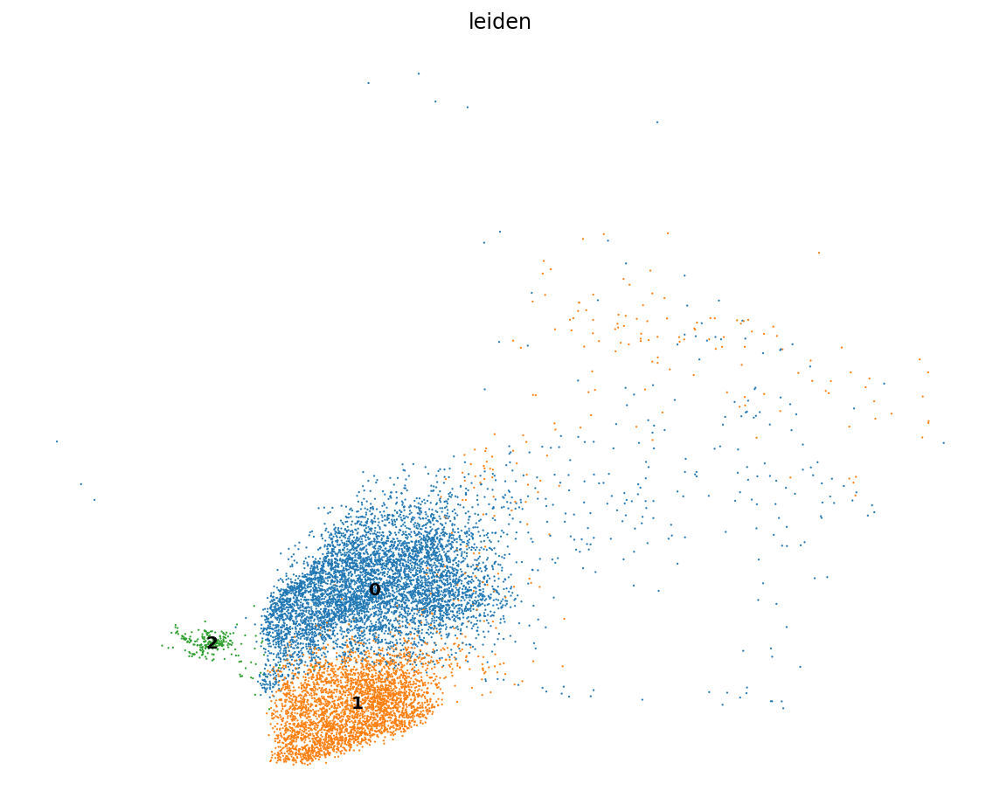

In [ ]:
sc.pl.umap(
    cl10,
    color="leiden",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)

In [141]:
sc.tl.rank_genes_groups(cl10, "leiden", method="t-test", n_genes=200)

In [142]:
markers10 = sc_utils.get_markers(cl10, "leiden")

In [143]:
markers10.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [144]:
markers10.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
9,3.672129e-276,3.778310,0.316481,0.022937,3.672129e-276,0,E2F1
29,1.616197e-172,3.467474,0.231779,0.017137,1.616197e-172,0,MCM2
108,7.565731e-89,3.451881,0.123441,0.008700,7.565731e-89,0,CCNE1
48,4.393692e-130,3.205630,0.197965,0.014500,4.393692e-130,0,CCNE2
3,0.000000e+00,3.151339,0.382633,0.050092,0.000000e+00,0,MCM6
231,3.232166e-144,3.867885,0.248110,0.022965,3.232166e-144,1,TMEM71
222,1.421907e-166,3.057938,0.321759,0.050523,1.421907e-166,1,SPTBN1
287,8.708268e-80,3.017953,0.163260,0.027716,8.708268e-80,1,CD300E
201,0.000000e+00,2.803443,0.795575,0.342255,0.000000e+00,1,PTTG1
210,2.016597e-242,2.658536,0.449174,0.179918,2.016597e-242,1,CCNB1


In [145]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype(str)

In [146]:
adata.obs.loc[cl10.obs_names[cl10.obs.leiden.isin(['0', '1'])], "leiden_scVI"] = "Proliferating macrophages"
adata.obs.loc[cl10.obs_names[cl10.obs.leiden.eq("2")], "leiden_scVI"] = "Proliferating T cells"

In [147]:
adata.obs.leiden_scVI = adata.obs.leiden_scVI.astype("category")

# 8. Annotate clusters

In [148]:
adata.shape

(197939, 1000)

In [149]:
adata = adata[adata.obs.leiden_scVI.ne('16'), :].copy()

In [150]:
adata.shape

(197208, 1000)

In [151]:
sc.tl.rank_genes_groups(adata, "leiden_scVI", method="t-test", n_genes=200)

In [152]:
markers = sc_utils.get_markers(adata, "leiden_scVI")

In [153]:
markers.sort_values(["cluster", "avg_logFC"], ascending=[True, False], inplace=True)

In [154]:
markers.groupby("cluster").head(5)

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
0,0.000000e+00,2.246737,0.858966,0.433060,0.000000e+00,0,INHBA
66,0.000000e+00,1.797220,0.266013,0.111058,0.000000e+00,0,SPOCD1
7,0.000000e+00,1.678656,0.678954,0.389480,0.000000e+00,0,TGM2
62,0.000000e+00,1.591287,0.302517,0.147004,0.000000e+00,0,SLC19A3
2,0.000000e+00,1.576875,0.859878,0.573271,0.000000e+00,0,TFRC
256,1.052218e-176,6.057820,0.157087,0.003699,1.052218e-176,11,MT1M
240,2.283108e-243,6.008699,0.196289,0.005467,2.283108e-243,11,MT1H
208,0.000000e+00,5.781182,0.432478,0.021127,0.000000e+00,11,MT1G
392,5.020801e-56,5.587014,0.050084,0.002073,5.020801e-56,11,MT1A
204,0.000000e+00,4.629587,0.610910,0.061056,0.000000e+00,11,MT1X


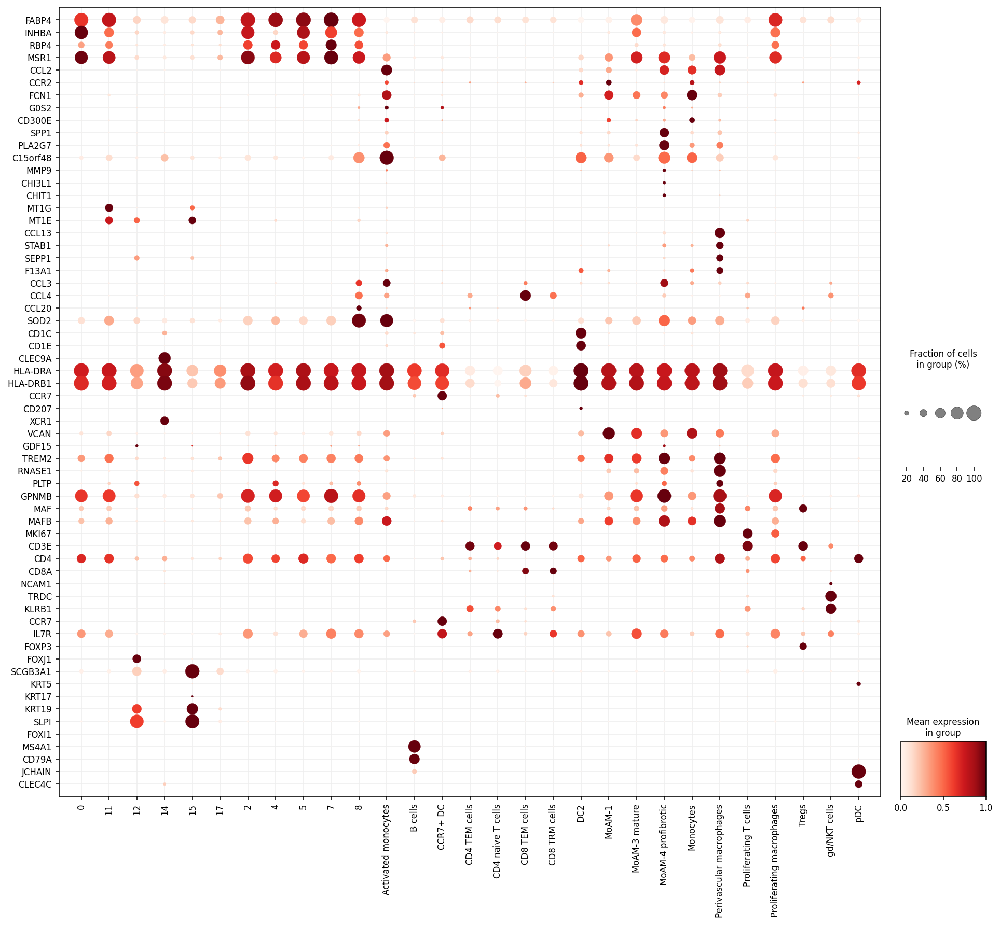

In [ ]:
ax = sc.pl.dotplot(
    adata,
    ["FABP4", "INHBA", "RBP4", "MSR1", "CCL2", "CCR2", "FCN1", "G0S2", "CD300E", # TRAM + MoAM + mono
     "SPP1", "PLA2G7", "C15orf48", "MMP9", "CHI3L1", "CHIT1", # profibrotic
     "MT1G", "MT1E", "CCL13", "STAB1", "SEPP1", "F13A1", # perivascular
     "CCL3", "CCL4", "CCL20", "SOD2", # activated
     "CD1C", "CD1E", "CLEC9A", "HLA-DRA", "HLA-DRB1", "CCR7", "CD207", "XCR1", # DC1/2
     "VCAN", "GDF15", "TREM2", "RNASE1", "PLTP", "GPNMB", "MAF", "MAFB", "MKI67", # misc
     "CD3E", "CD4", "CD8A", "NCAM1", "TRDC", "KLRB1", "CCR7", "IL7R", "FOXP3", # T cells
     "FOXJ1", "SCGB3A1", "KRT5", "KRT17", "KRT19", "SLPI", "FOXI1", # Epithelial cells
     "MS4A1", "CD79A", "JCHAIN", "CLEC4C", # B cells / plasma
    ],
    "leiden_scVI",
    swap_axes=True,
    figsize=(16, 14),
    standard_scale="var",
    edgecolor=None,
    show=False,
    zorder=2
)
ax["mainplot_ax"].grid(c="#eeeeee", zorder=0)

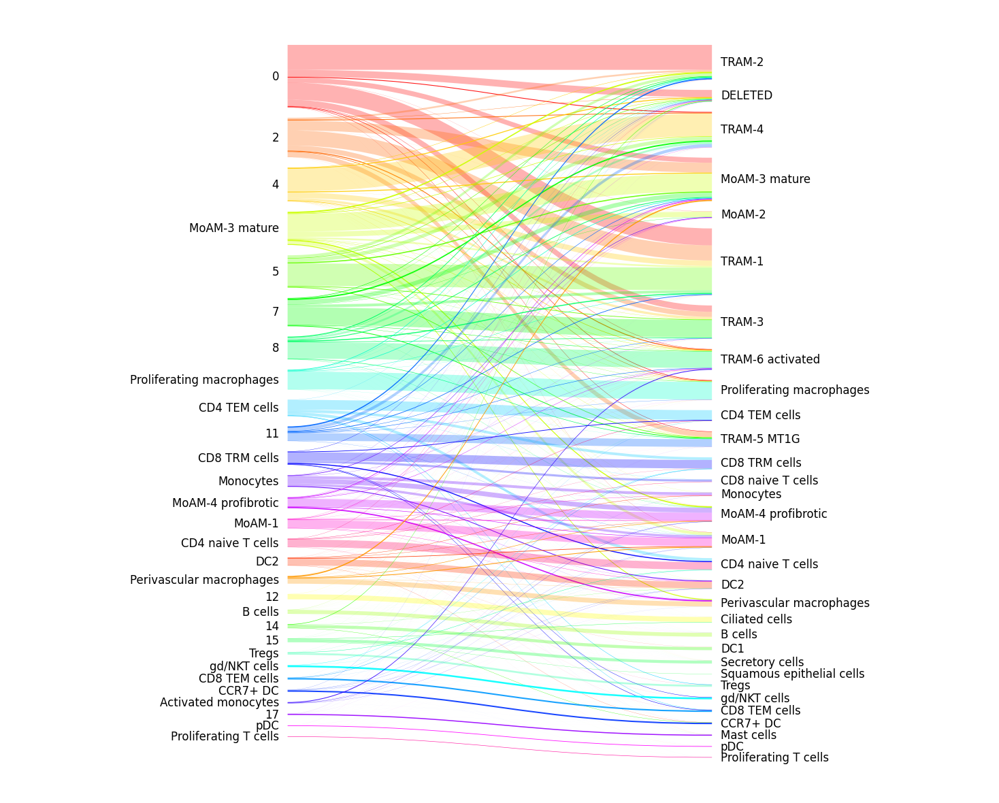

In [156]:
sankey.sankey(adata.obs.leiden_scVI, adata_30[adata.obs_names]);

In [157]:
names = """
0: TRAM-2
2: TRAM-1
4: TRAM-4
5: TRAM-1
7: TRAM-3
8: TRAM-6 activated
11: TRAM-5 MT1G
12: Ciliated cells
14: DC1
15: Secretory cells
17: Mast cells
""".strip().split("\n")

In [158]:
names = {x.split(":")[0].strip() : x.split(":")[1].strip() for x in names}

In [159]:
adata.obs["cell_type"] = adata.obs.leiden_scVI.replace(names)

In [160]:
adata.obs.cell_type.value_counts()

TRAM-1                       35246
TRAM-2                       30709
TRAM-4                       16637
MoAM-3 mature                16283
TRAM-3                       13879
TRAM-6 activated             11170
Proliferating macrophages     9663
CD4 TEM cells                 7993
TRAM-5 MT1G                   7168
CD8 TRM cells                 6587
Monocytes                     5740
MoAM-4 profibrotic            5419
MoAM-1                        4749
CD4 naive T cells             4169
DC2                           3947
Perivascular macrophages      3801
Ciliated cells                2596
B cells                       2015
DC1                           1955
Secretory cells               1681
Tregs                         1140
gd/NKT cells                  1031
CD8 TEM cells                  950
CCR7+ DC                       937
Activated monocytes            607
Mast cells                     592
pDC                            322
Proliferating T cells          222
Name: cell_type, dty

In [161]:
adata.obs.cell_type = adata.obs.cell_type.astype("category")

<AxesSubplot:title={'center':'Cell_type by Patient'}>

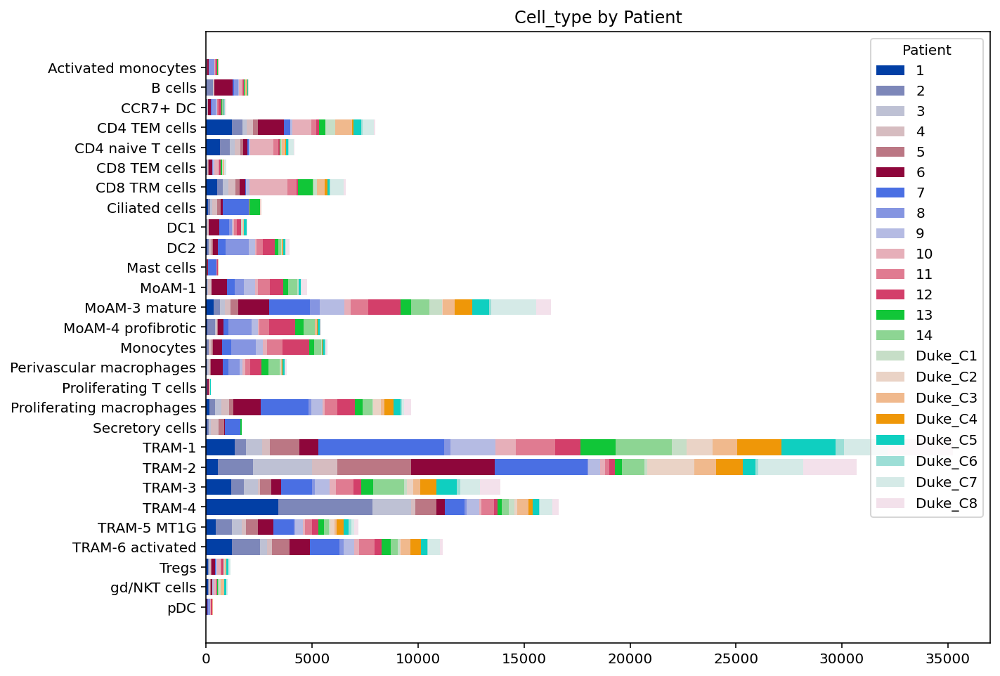

In [162]:
sc_utils.plot_composition(adata, group_by="cell_type", color="Patient")

<AxesSubplot:title={'center':'Cell_type by Study'}>

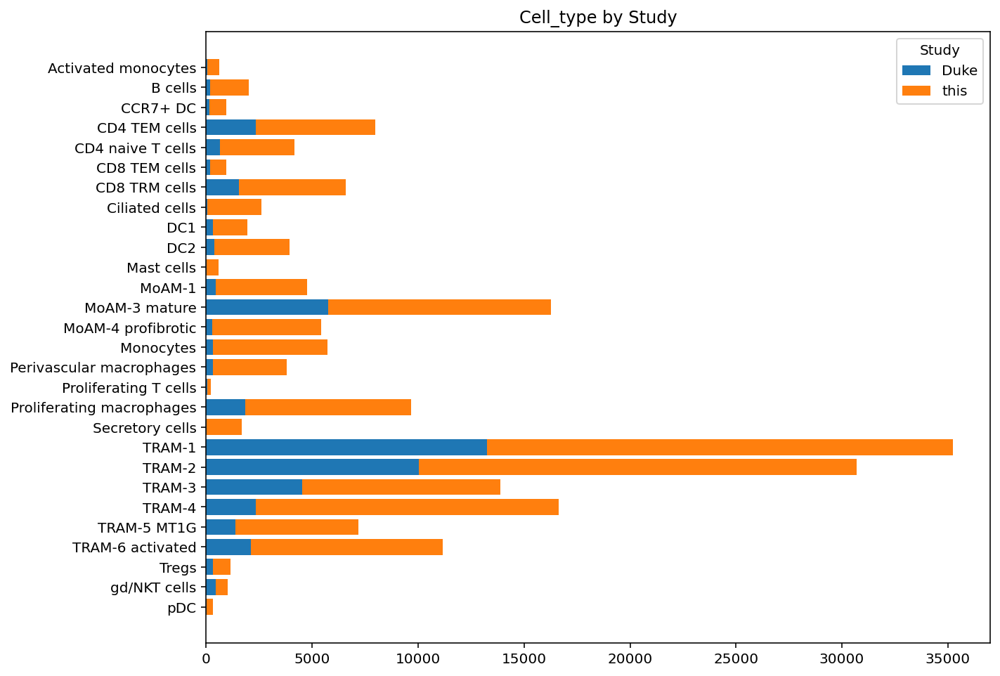

In [163]:
sc_utils.plot_composition(adata, group_by="cell_type", color="Study")

<AxesSubplot:title={'center':'Cell_type by Chemistry'}>

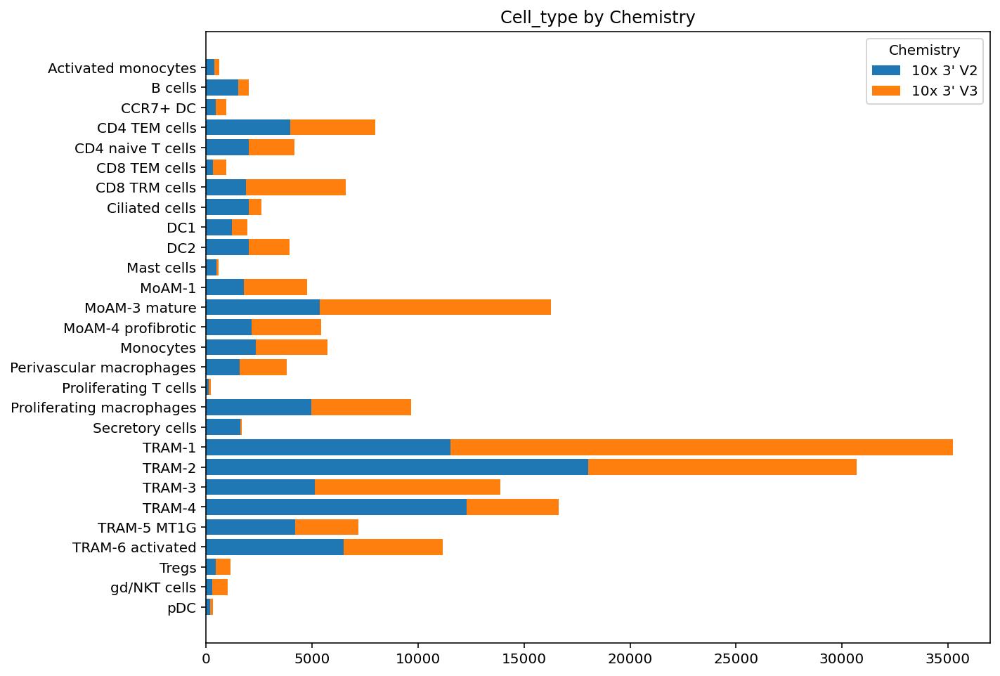

In [164]:
sc_utils.plot_composition(adata, group_by="cell_type", color="Chemistry")

<AxesSubplot:title={'center':'Cell_type by Status'}>

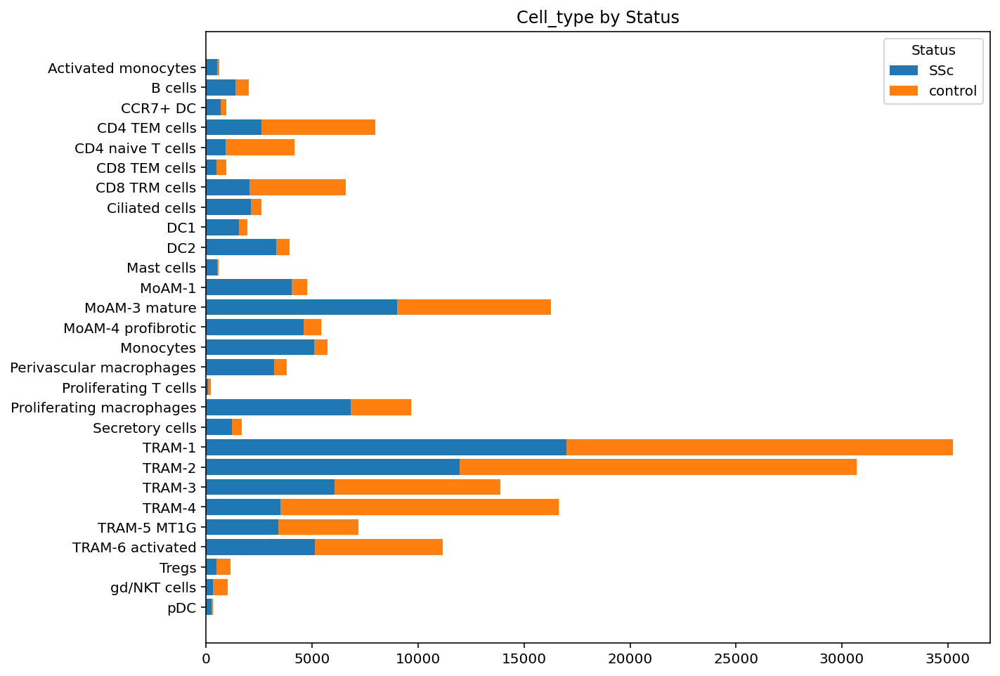

In [165]:
sc_utils.plot_composition(adata, group_by="cell_type", color="Status")

<AxesSubplot:ylabel='total_counts'>

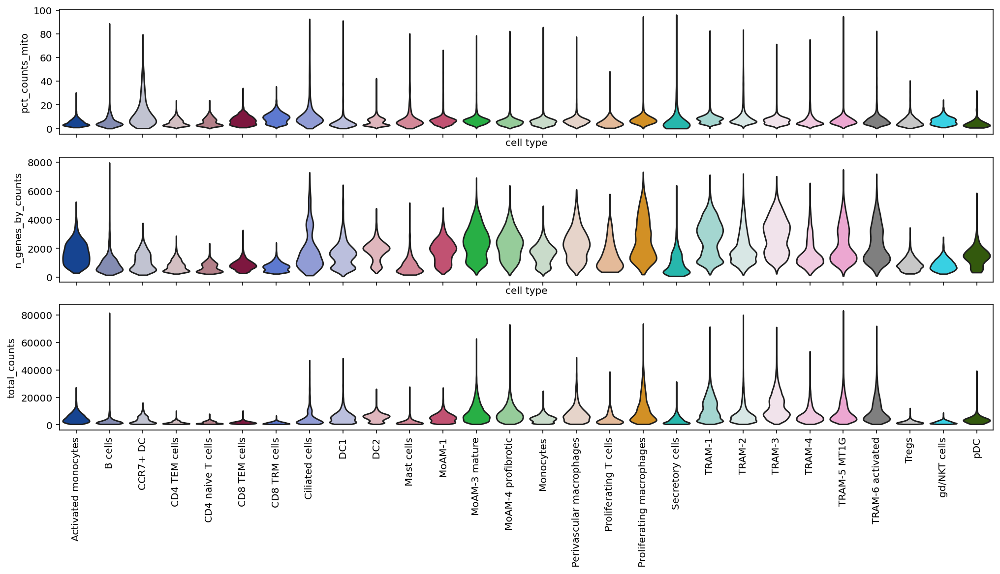

In [166]:
fig, ax = plt.subplots(nrows=3, figsize=(14, 8), constrained_layout=True, sharex=True)

sc.pl.violin(adata, "pct_counts_mito", groupby="cell_type", ax=ax[0], show=False, size=0)
sc.pl.violin(adata, "n_genes_by_counts", groupby="cell_type", ax=ax[1], show=False, size=0)
sc.pl.violin(adata, "total_counts", groupby="cell_type", ax=ax[2], show=False, size=0, rotation=90)

Save progress

In [167]:
adata.write_h5ad("../../data/31_bal-object/03_annotated.h5ad")

<AxesSubplot:title={'center':'cell_type'}, xlabel='UMAP1', ylabel='UMAP2'>

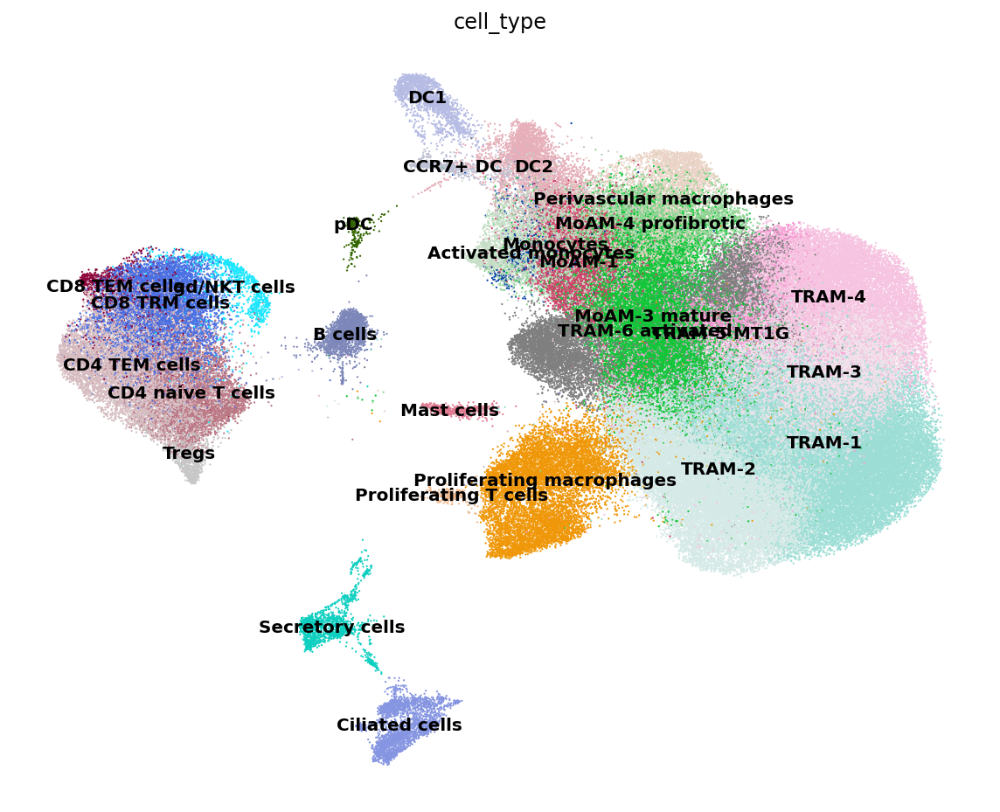

In [ ]:
sc.pl.umap(
    adata,
    color="cell_type",
    frameon=False,
    legend_loc="on data",
    show=False,
    size=5
)